In [2]:
import os
os.chdir('mmpose')

In [12]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-m-Dog_hip_CA/best_PCK_epoch_190.pth \
        checkpoint/CA_epoch_190.pth

08/04 02:45:42 - mmengine - INFO - Key `message_hub` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
08/04 02:45:42 - mmengine - INFO - Key `ema_state_dict` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.


In [ ]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-l-Dog_hip_head/best_PCK_epoch_20.pth \
        checkpoint/head_epoch_200.pth

In [1]:
import cv2
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline
import scipy
import pandas as pd

import torch

import mmcv
from mmcv import imread
import mmengine
from mmengine.registry import init_default_scope

from mmpose.apis import inference_topdown
from mmpose.apis import init_model as init_pose_estimator
from mmpose.evaluation.functional import nms
from mmpose.registry import VISUALIZERS
from mmpose.structures import merge_data_samples
import matplotlib.patches as patches

from mmdet.apis import inference_detector, init_detector



ModuleNotFoundError: No module named 'mmpose.apis'

In [4]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('device', device)

device cuda:0


In [5]:
# faster rcnn
detector = init_detector(
    '/home/featurize/work/mmdetection/data/faster_r_cnn_dog_hip_AC_FH.py',
    
    '/home/featurize/work/mmdetection/checkpoint/faster_r_cnn_dog_hip_acfh_-56ce5bbe.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/faster_r_cnn_dog_hip_acfh_-56ce5bbe.pth


In [6]:
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'
init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

detect_result = inference_detector(detector, img_path)

In [7]:
detect_result.keys()

['gt_instances', 'ignored_instances', 'pred_instances']

In [8]:
labels =detect_result.pred_instances.labels
labels

tensor([1, 1, 0, 0], device='cuda:0')

In [9]:
scores = detect_result.pred_instances.scores
scores 

tensor([0.9999, 0.9999, 0.1264, 0.0971], device='cuda:0')

In [10]:
bboxes=detect_result.pred_instances.bboxes[:]
bboxes

tensor([[203.6820, 118.2421, 314.2091, 228.9741],
        [670.2206, 102.1867, 777.0370, 208.9995],
        [237.8673,  91.8255, 751.6448, 113.6888],
        [247.9118,  99.0329, 731.9697, 136.5133]], device='cuda:0')

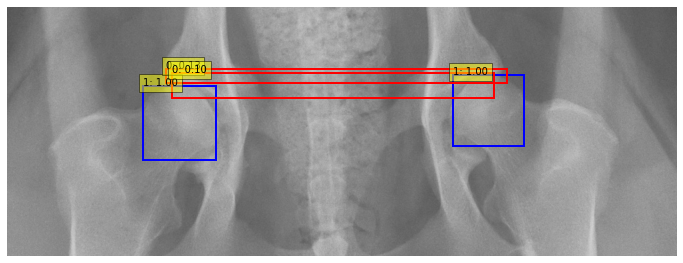

In [11]:
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'
image = Image.open(img_path)
scores = scores.cpu().numpy()
bboxes = bboxes.cpu().numpy()
labels = labels.cpu().numpy()

# 加载图像
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'
image = Image.open(img_path)

# 显示图像
fig, ax = plt.subplots(1, figsize=(12, 12))
ax.imshow(image)

# 不同类别的颜色
colors = ['r', 'b']

# 绘制边界框
for i in range(len(bboxes)):
    bbox = bboxes[i]
    label = labels[i]
    score = scores[i]

    # 边界框的左上角坐标和宽高
    x, y, width, height = bbox[0], bbox[1], bbox[2] - bbox[0], bbox[3] - bbox[1]

    # 创建矩形补丁
    rect = patches.Rectangle((x, y), width, height, linewidth=2, edgecolor=colors[label], facecolor='none')
    ax.add_patch(rect)

    # 添加标签和分数
    plt.text(x, y, f'{label}: {score:.2f}', bbox=dict(facecolor='yellow', alpha=0.5))

plt.axis('off')
plt.show()

In [ ]:
# RTMDet 
#detector = init_detector(
#    'data/rtmdet_tiny_triangle.py',
#    'checkpoint/rtmdet_tiny_triangle_epoch_200_202305120847-3cd02a8f.pth',
#    device=device
#)

In [13]:
pose_estimator = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-m-Dog_hip_CA.py',
    '/home/featurize/work/mmpose/checkpoint/CA_epoch_190-4624ec1a_20240804.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/CA_epoch_190-4624ec1a_20240804.pth


In [4]:
# Rtm_det 
detector2 = init_detector(
    '/home/featurize/work/mmdetection/data/rtmdet_l_dog_hip_head.py',
    
    '/home/featurize/work/mmdetection/checkpoint/best_head_bbox_mAP_epoch_40-9ce1502a.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/best_head_bbox_mAP_epoch_40-9ce1502a.pth


In [7]:
pose_estimator2 = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-l-Dog_hip_head.py',
    '/home/featurize/work/mmpose/checkpoint/head_epoch_200-c51f8fad_20240721.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

07/22 02:57:45 - mmengine - WARNING - The current default scope "mmdet" is not "mmpose", `init_default_scope` will force set the currentdefault scope to "mmpose".
Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/head_epoch_200-c51f8fad_20240721.pth


Processing /home/featurize/work/Dataset2/data/Testing/Images/340563.jpeg
center: [[[525 166]]

 [[221 130]]]
head: [[[517 139]]

 [[243 111]]]


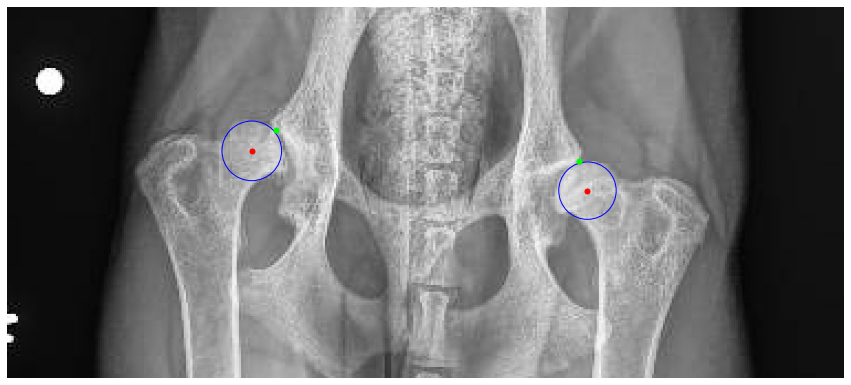

Processing /home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg
center: [[[480 105]]

 [[164  93]]]
head: [[[459 114]]]


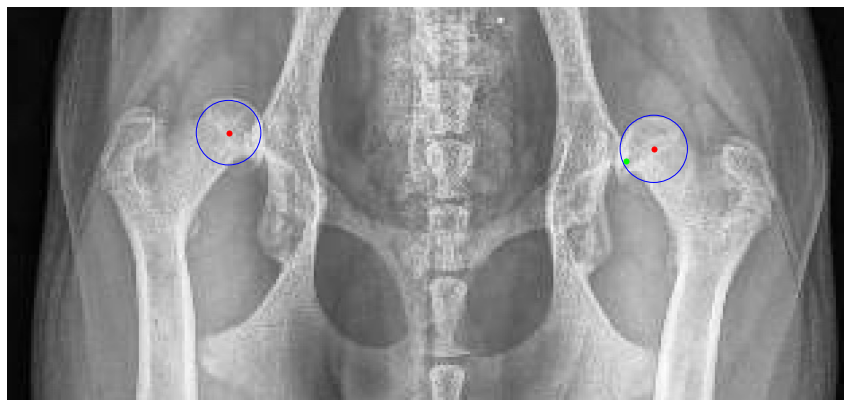

Processing /home/featurize/work/Dataset2/data/Testing/Images/328949.jpeg
center: [[[696 192]]

 [[317 171]]]
head: [[[342 140]]

 [[683 154]]]


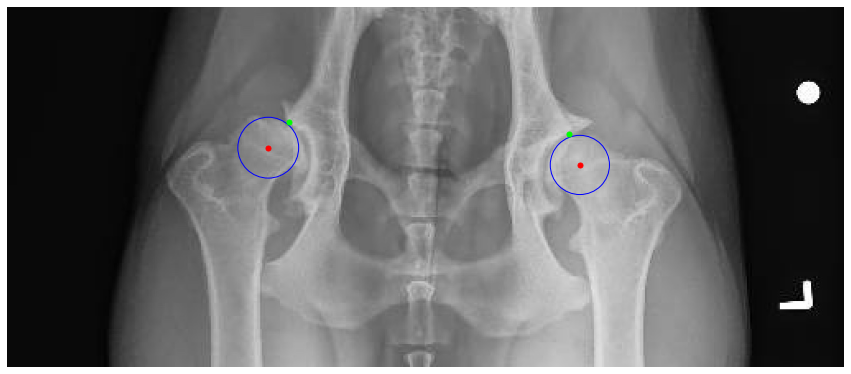

Processing /home/featurize/work/Dataset2/data/Testing/Images/348742.jpeg
center: [[[435 152]]

 [[204 142]]]
head: [[[447 123]]

 [[197 113]]]


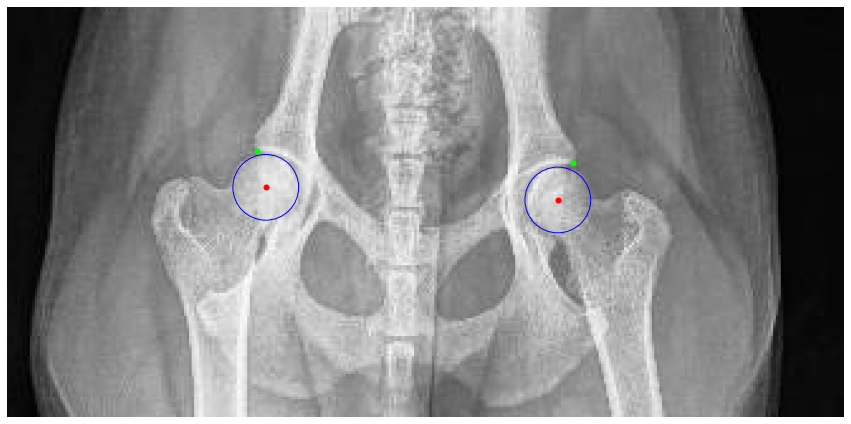

Processing /home/featurize/work/Dataset2/data/Testing/Images/355767.jpeg
center: [[[296 149]]

 [[603 158]]]
head: [[[616 119]]

 [[287 109]]]


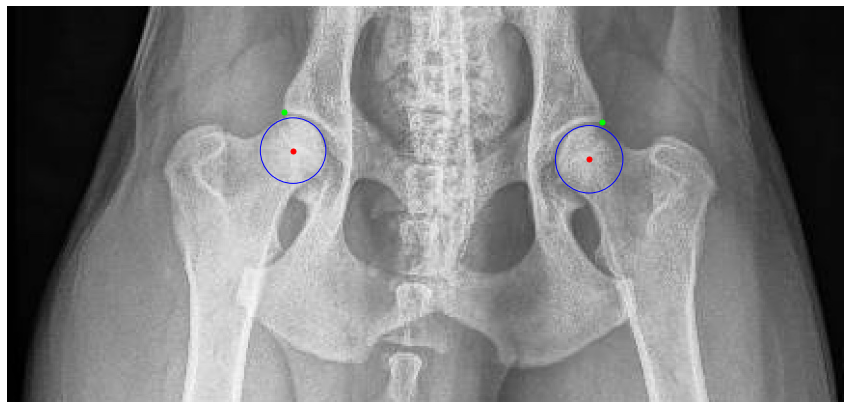

Processing /home/featurize/work/Dataset2/data/Testing/Images/353517.jpeg
center: [[[192 125]]

 [[451 118]]]
head: [[[182  97]]

 [[453  86]]]


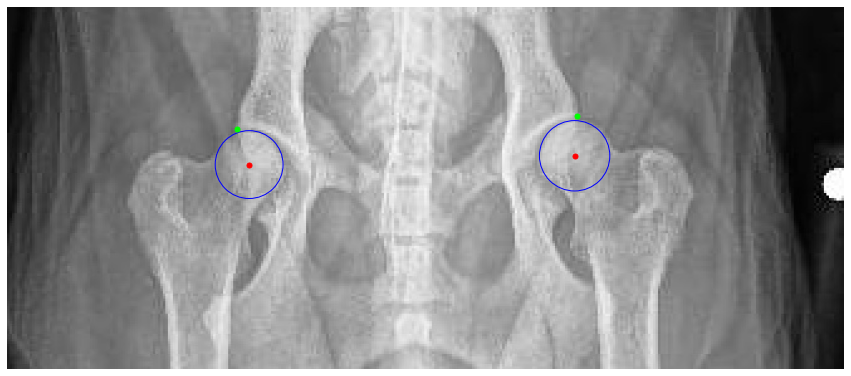

Processing /home/featurize/work/Dataset2/data/Testing/Images/355524.jpeg
center: [[[172 150]]

 [[484 151]]]
head: [[[478 116]]

 [[183 115]]]


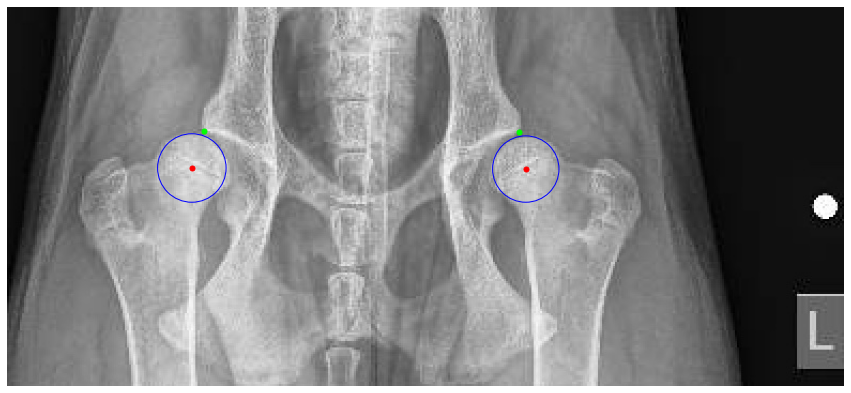

Processing /home/featurize/work/Dataset2/data/Testing/Images/358587.jpeg
center: [[[399  88]]

 [[179  95]]]
head: [[[172  70]]

 [[405  62]]]


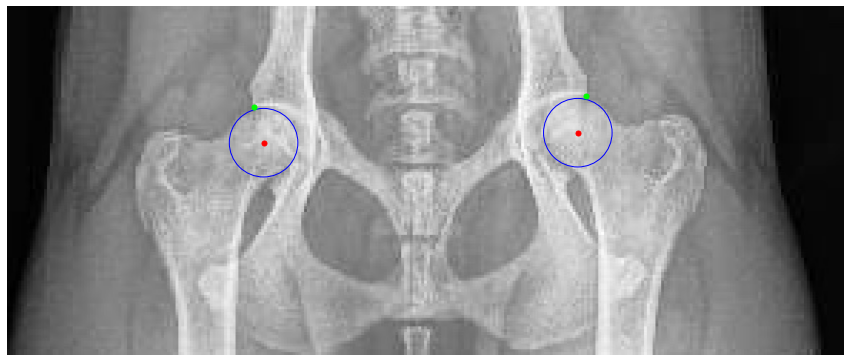

Processing /home/featurize/work/Dataset2/data/Testing/Images/355223.jpeg
center: [[[372 144]]

 [[615 146]]]
head: [[[621 121]]

 [[364 119]]]


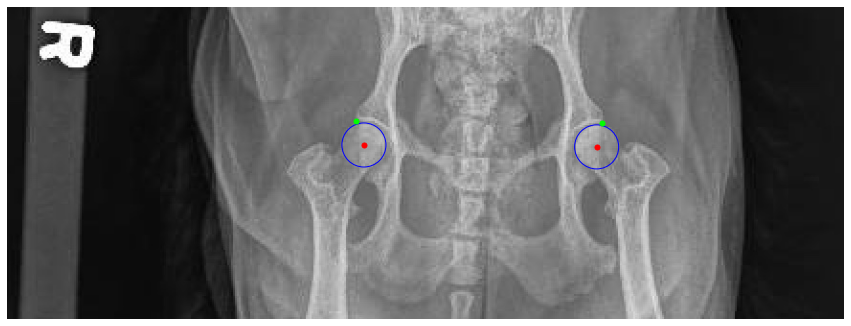

Processing /home/featurize/work/Dataset2/data/Testing/Images/264113.jpeg
center: [[[581 136]]

 [[303 112]]]
head: [[[594 102]]

 [[301  77]]]


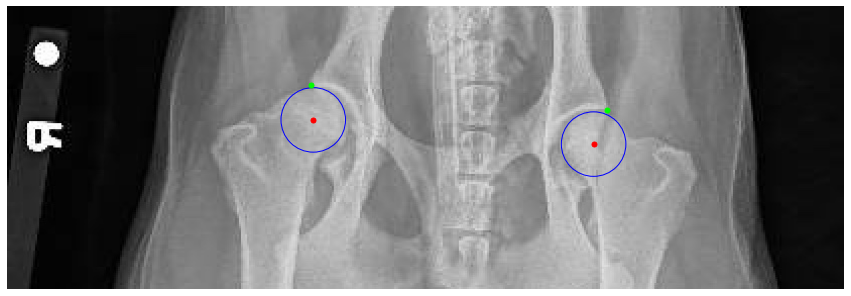

Processing /home/featurize/work/Dataset2/data/Testing/Images/365780.jpeg
center: [[[569 181]]

 [[225 163]]]
head: [[[209 118]]

 [[591 138]]]


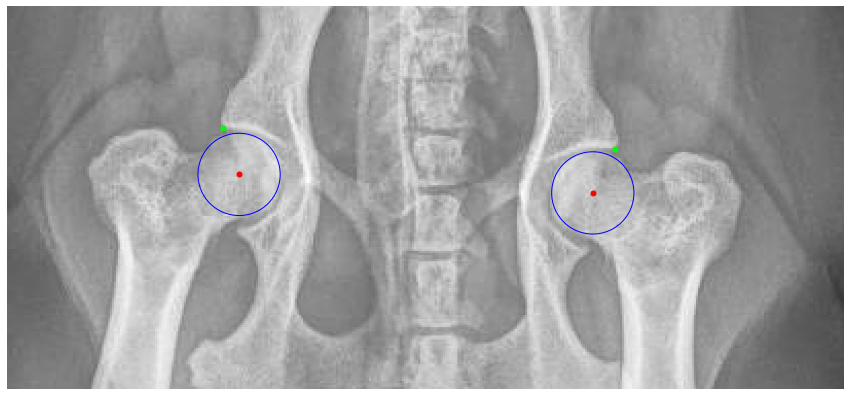

Processing /home/featurize/work/Dataset2/data/Testing/Images/360388.jpeg
center: [[[155  93]]

 [[434 114]]]
head: [[[447  82]]

 [[148  58]]]


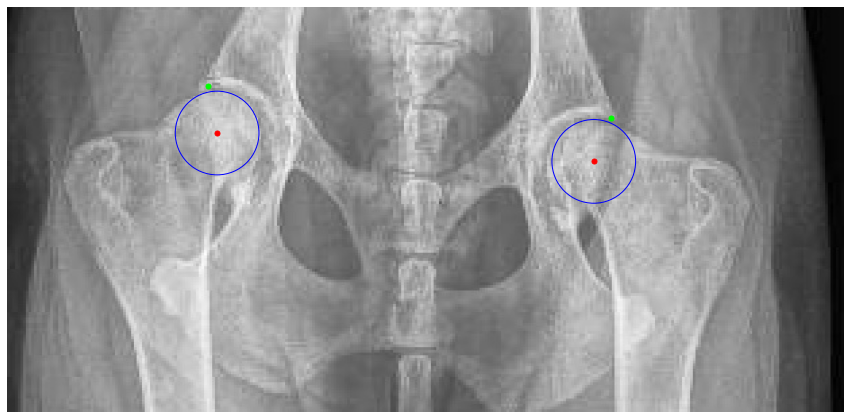

Processing /home/featurize/work/Dataset2/data/Testing/Images/246775.jpeg
center: [[[126  50]]

 [[277  51]]]
head: [[[284  34]]

 [[120  33]]]


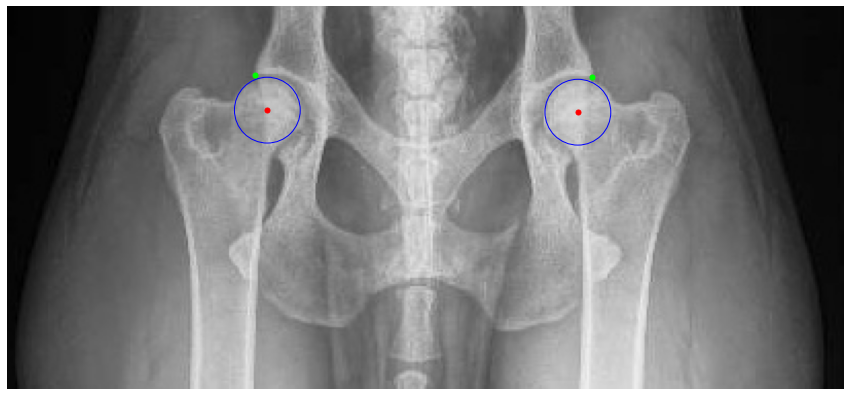

Processing /home/featurize/work/Dataset2/data/Testing/Images/361492.jpeg
center: [[[497 103]]

 [[180 111]]]
head: [[[501  69]]

 [[176  75]]]


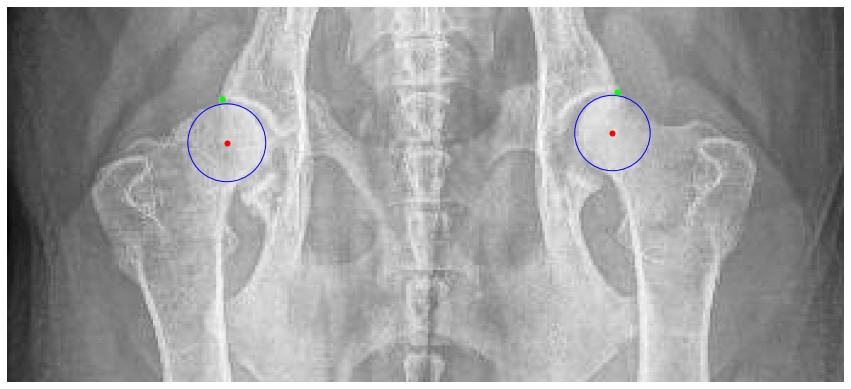

Processing /home/featurize/work/Dataset2/data/Testing/Images/336938.jpeg
center: [[[227 157]]

 [[477 173]]]
head: [[[486 142]]

 [[220 126]]]


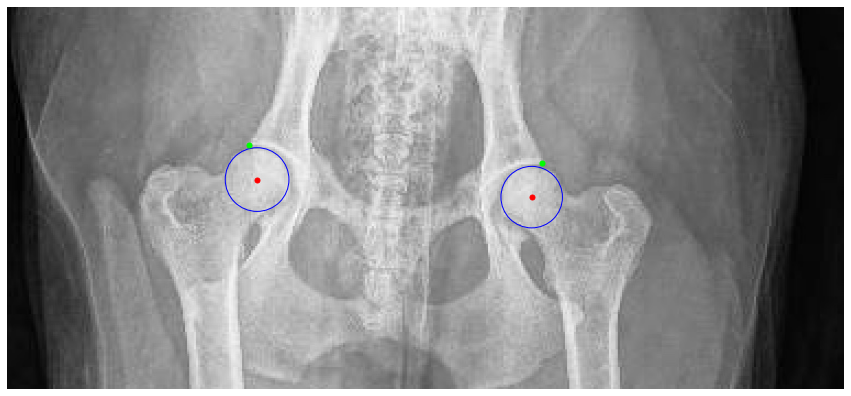

Processing /home/featurize/work/Dataset2/data/Testing/Images/358275.jpeg
center: [[[184 119]]

 [[425 121]]]
head: [[[181  92]]

 [[424  95]]]


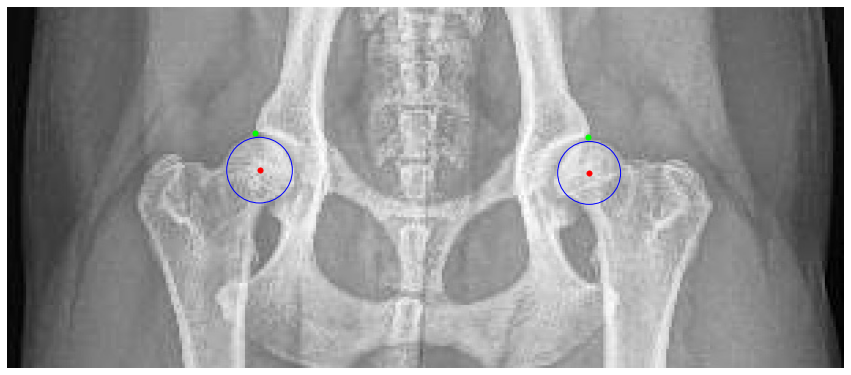

Processing /home/featurize/work/Dataset2/data/Testing/Images/364394.jpeg
center: [[[380  86]]

 [[144  84]]]
head: [[[133  56]]

 [[390  60]]]


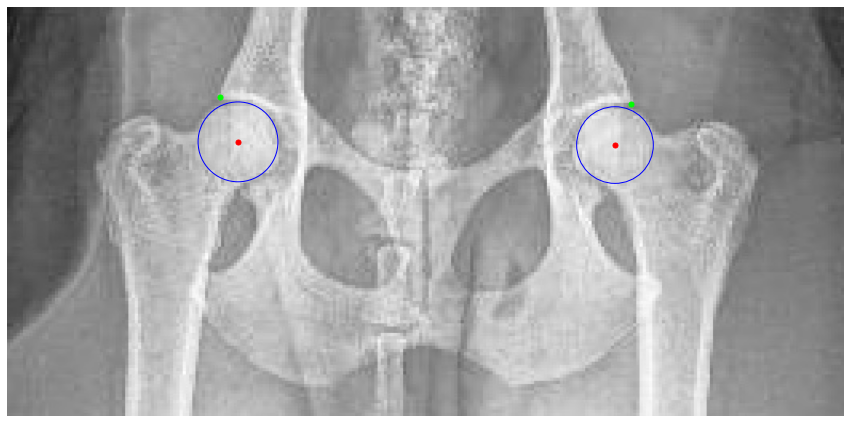

Processing /home/featurize/work/Dataset2/data/Testing/Images/353262.jpg
center: [[[ 482  348]]

 [[1291  213]]]
head: [[[1295  113]]

 [[ 429  256]]]


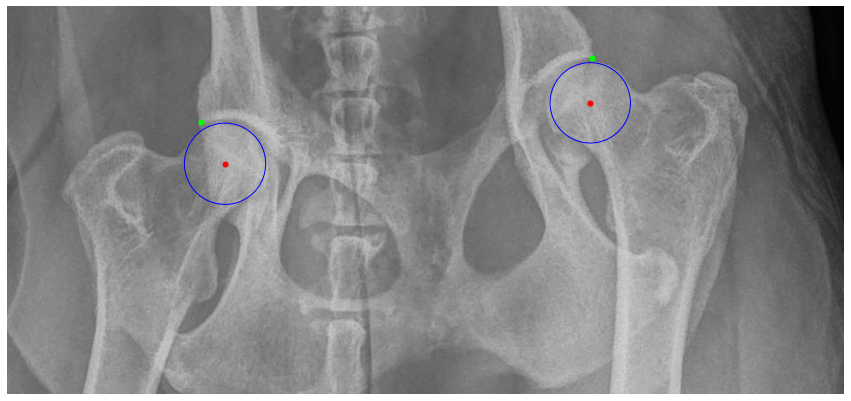

Processing /home/featurize/work/Dataset2/data/Testing/Images/359216.jpeg
center: [[[169 116]]

 [[406 122]]]
head: [[[169  79]]

 [[412  84]]]


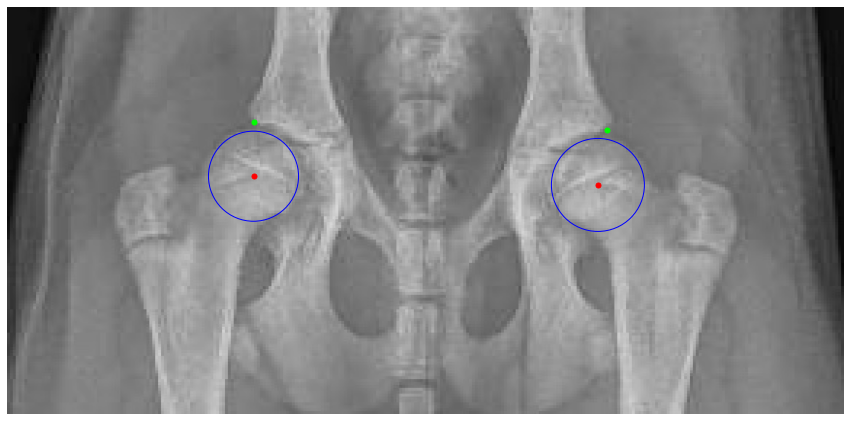

Processing /home/featurize/work/Dataset2/data/Testing/Images/352697.jpeg
center: [[[216 132]]

 [[502 131]]]
head: [[[509 101]]

 [[204 101]]]


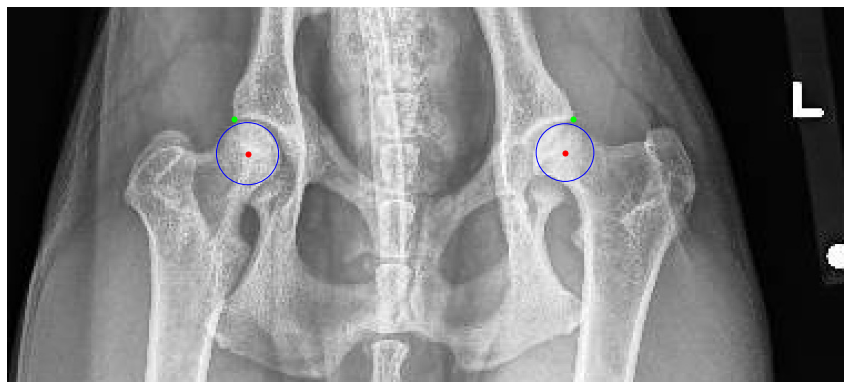

Processing /home/featurize/work/Dataset2/data/Testing/Images/359792.jpeg
center: [[[178 105]]

 [[447 130]]]
head: [[[462 100]]

 [[175  74]]]


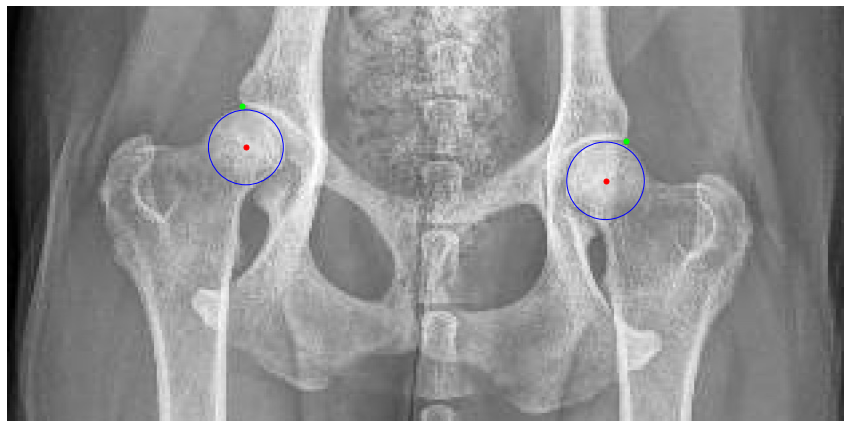

Processing /home/featurize/work/Dataset2/data/Testing/Images/360132.jpeg
center: [[[164  96]]

 [[456 105]]]
head: [[[149  62]]

 [[473  71]]]


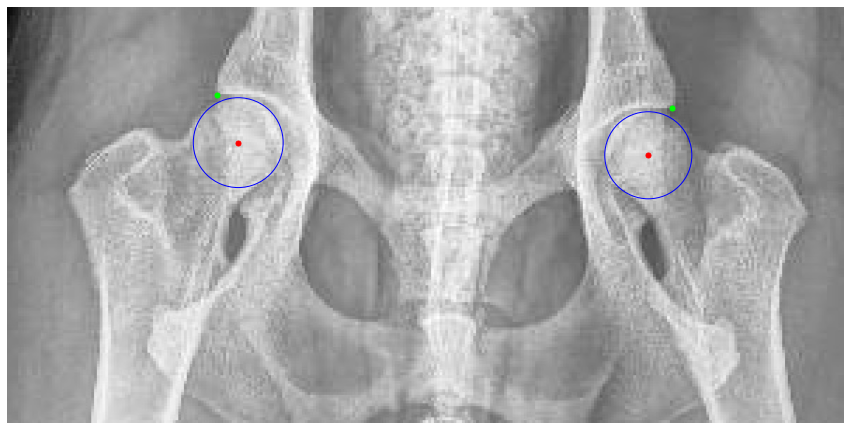

Processing /home/featurize/work/Dataset2/data/Testing/Images/251256.jpg
center: [[[1016  292]]

 [[ 303  208]]]
head: [[[ 327  121]]

 [[1069  222]]]


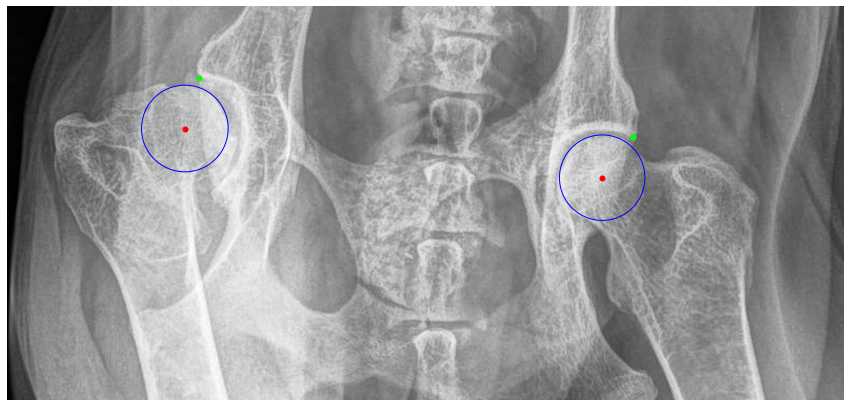

Processing /home/featurize/work/Dataset2/data/Testing/Images/350186.jpeg
center: [[[505 160]]

 [[231 158]]]
head: [[[218 123]]

 [[518 129]]]


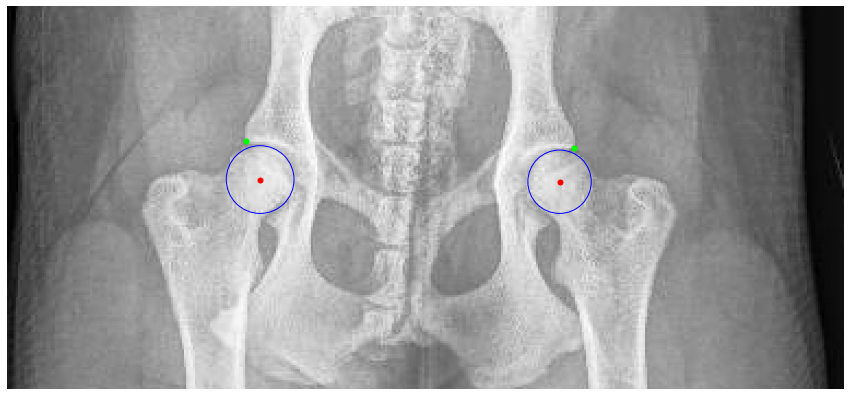

Processing /home/featurize/work/Dataset2/data/Testing/Images/367031.jpg
center: [[[969 213]]

 [[320 224]]]
head: [[[992 134]]

 [[289 146]]]


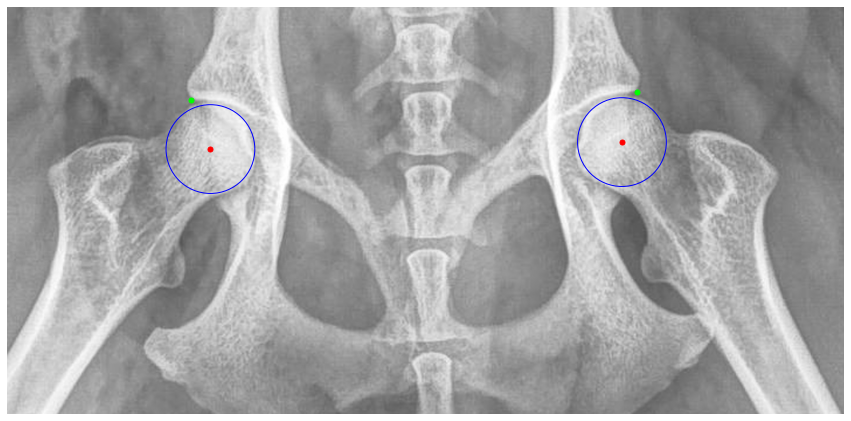

Processing /home/featurize/work/Dataset2/data/Testing/Images/348064.jpeg
center: [[[511 150]]

 [[231 162]]]
head: [[[525 113]]

 [[211 127]]]


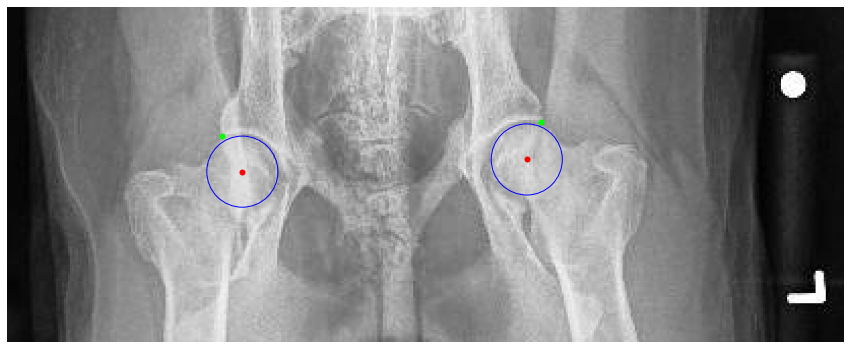

Processing /home/featurize/work/Dataset2/data/Testing/Images/337935.jpeg
center: [[[899 209]]

 [[421 252]]]
head: [[[403 196]]

 [[907 154]]]


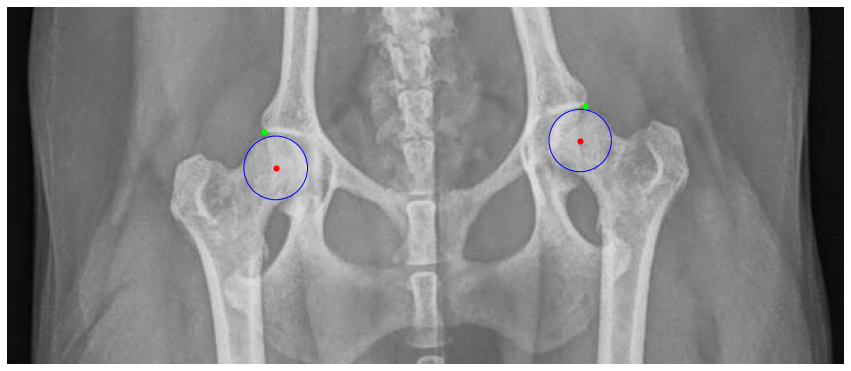

Processing /home/featurize/work/Dataset2/data/Testing/Images/360778.jpeg
center: [[[201 132]]

 [[543 140]]]
head: [[[540 102]]

 [[210  97]]]


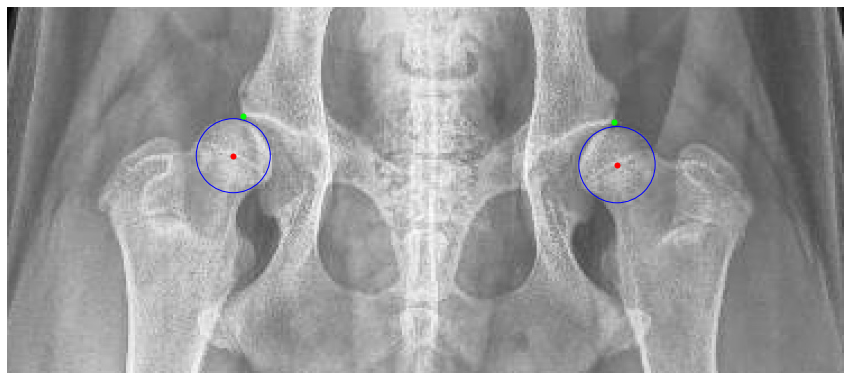

Processing /home/featurize/work/Dataset2/data/Testing/Images/204964.jpg
center: [[[1145  523]]

 [[ 343  338]]]
head: [[[ 324  242]]

 [[1204  434]]]


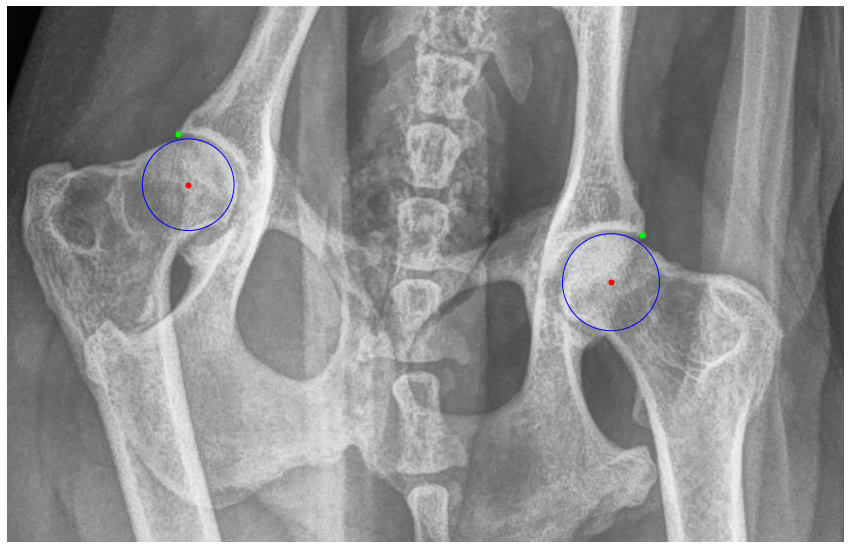

Processing /home/featurize/work/Dataset2/data/Testing/Images/357039.jpeg
center: [[[250 133]]

 [[507 122]]]
head: [[[517  91]]

 [[234 103]]]


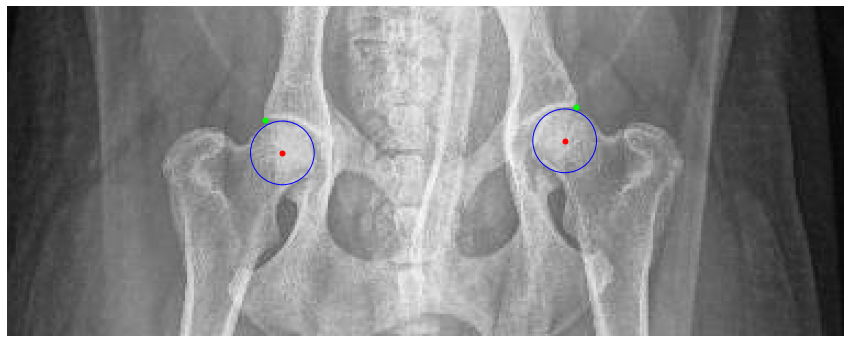

Processing /home/featurize/work/Dataset2/data/Testing/Images/261359.jpeg
center: [[[282  47]]

 [[121  55]]]
head: [[[287  29]]

 [[114  38]]]


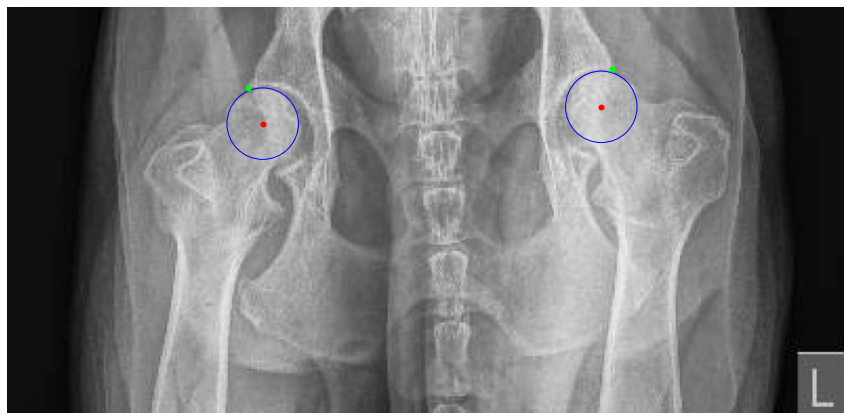

Processing /home/featurize/work/Dataset2/data/Testing/Images/363515.jpeg
center: [[[484 123]]

 [[197 108]]]
head: [[[498  88]]

 [[190  72]]]


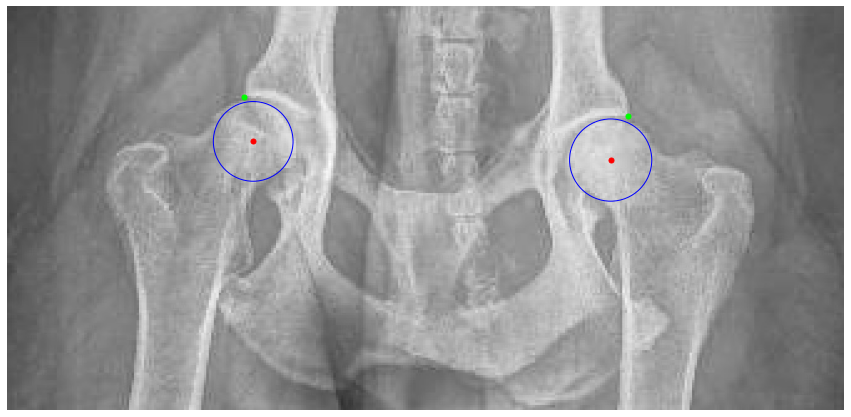

Processing /home/featurize/work/Dataset2/data/Testing/Images/359626.jpeg
center: [[[160 123]]

 [[407 120]]]
head: [[[417  91]]

 [[149  93]]]


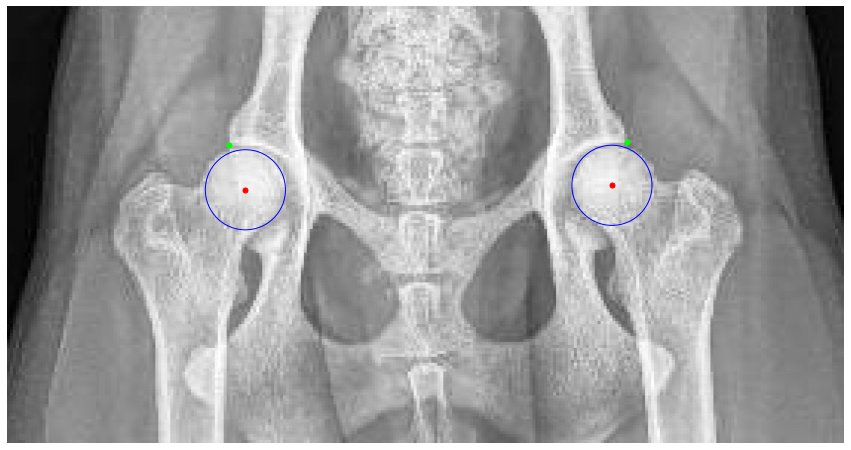

Processing /home/featurize/work/Dataset2/data/Testing/Images/341649.jpeg
center: [[[274 189]]

 [[607 198]]]
head: [[[585 176]]

 [[297 169]]]


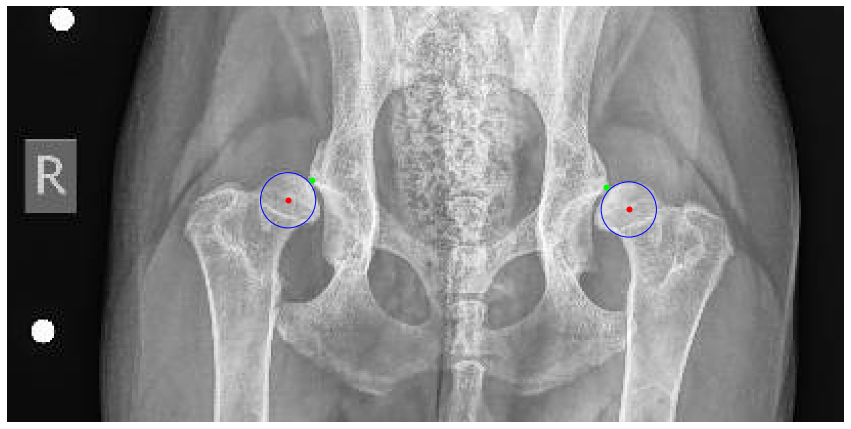

Processing /home/featurize/work/Dataset2/data/Testing/Images/348002.jpeg
center: [[[222 123]]

 [[445  89]]]
head: [[[452  60]]

 [[207  96]]]


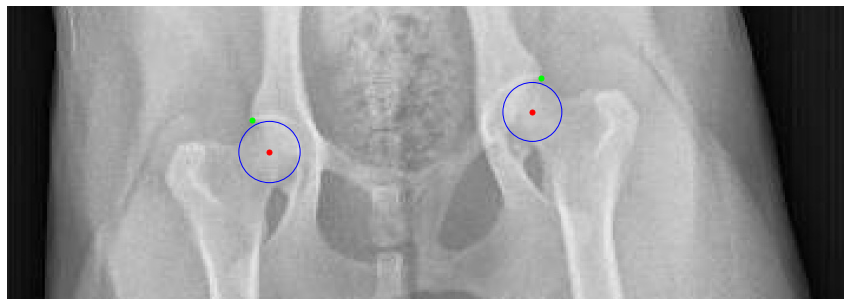

Processing /home/featurize/work/Dataset2/data/Testing/Images/359782.jpeg
center: [[[202 131]]

 [[510 132]]]
head: [[[520 100]]

 [[192  96]]]


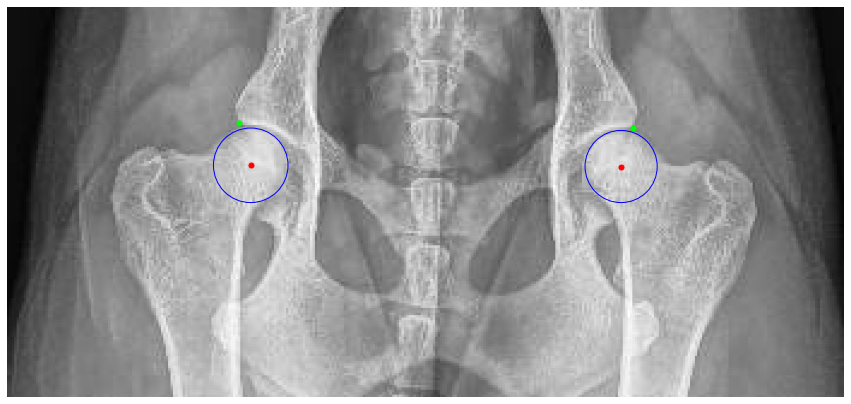

Processing /home/featurize/work/Dataset2/data/Testing/Images/270257.jpeg
center: [[[589 101]]

 [[295 127]]]
head: [[[284  92]]

 [[589  66]]]


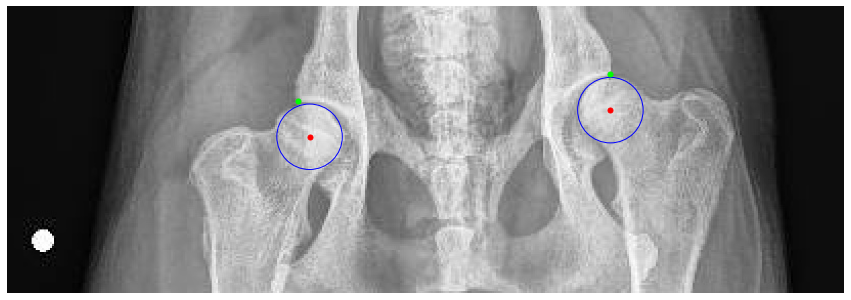

Processing /home/featurize/work/Dataset2/data/Testing/Images/350556.jpeg
center: [[[194 117]]

 [[470  97]]]
head: [[[188  86]]

 [[463  69]]]


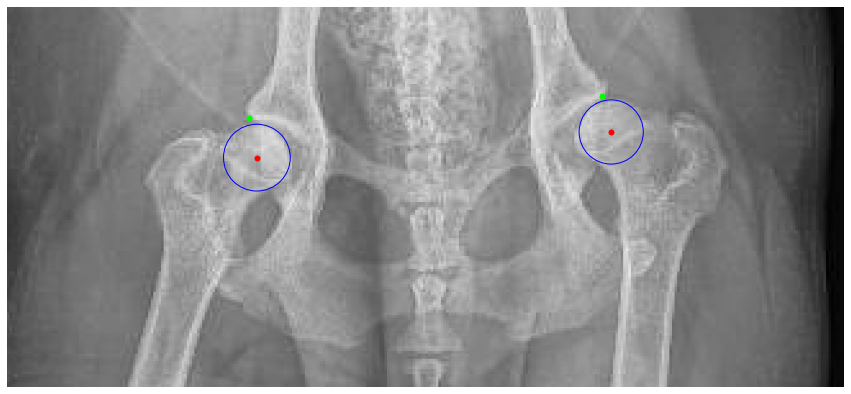

Processing /home/featurize/work/Dataset2/data/Testing/Images/360678.jpg
center: [[[1042  208]]

 [[ 323  213]]]
head: [[[1076  124]]

 [[ 287  130]]]


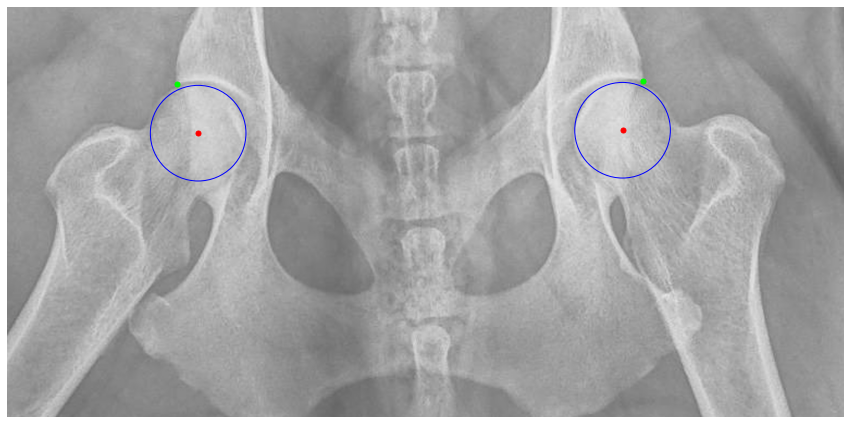

Processing /home/featurize/work/Dataset2/data/Testing/Images/364276.jpeg
center: [[[194 166]]

 [[448 151]]]
head: [[[460 112]]

 [[178 127]]]


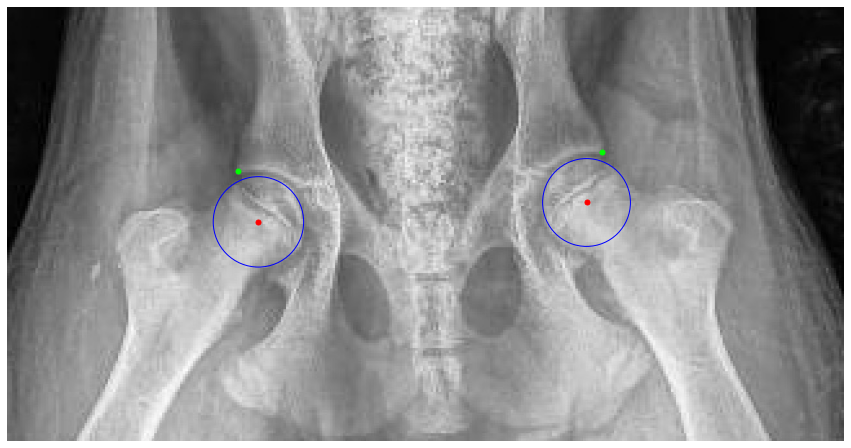

Processing /home/featurize/work/Dataset2/data/Testing/Images/349607.jpeg
center: [[[214 158]]

 [[510 149]]]
head: [[[517 117]]

 [[203 127]]]


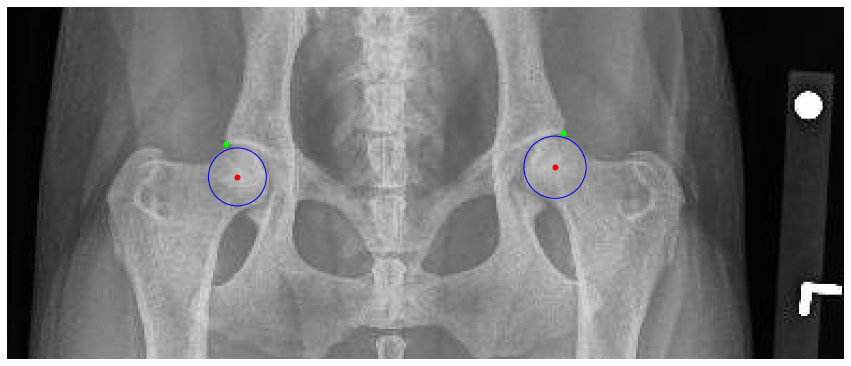

Processing /home/featurize/work/Dataset2/data/Testing/Images/302735.jpeg
center: [[[307 139]]

 [[551 145]]]
head: [[[294 110]]

 [[563 116]]]


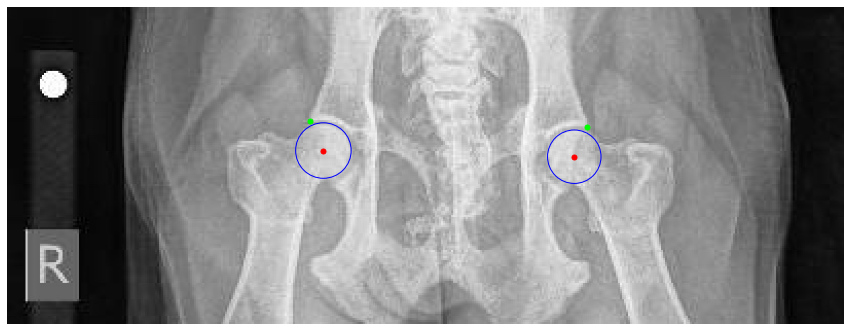

Processing /home/featurize/work/Dataset2/data/Testing/Images/361188.jpeg
center: [[[169 111]]

 [[413  91]]]
head: [[[420  55]]

 [[156  77]]]


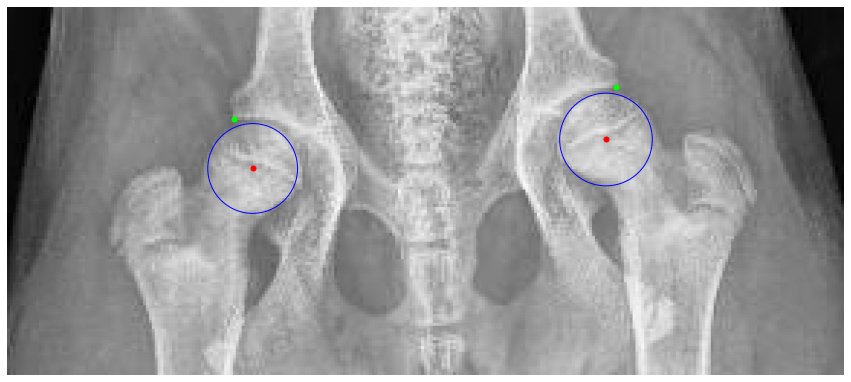

Processing /home/featurize/work/Dataset2/data/Testing/Images/335450.jpeg
center: [[[486 164]]

 [[248 149]]]
head: [[[245 120]]

 [[497 136]]]


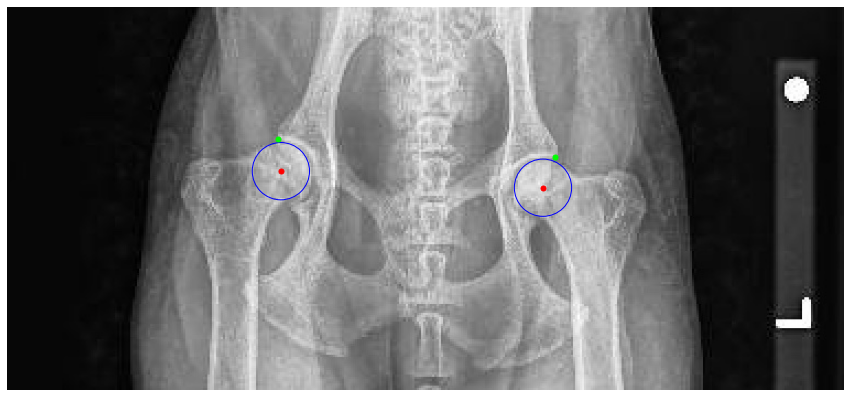

Processing /home/featurize/work/Dataset2/data/Testing/Images/352456.jpeg
center: [[[492 137]]

 [[230 128]]]
head: [[[503 107]]

 [[220  97]]]


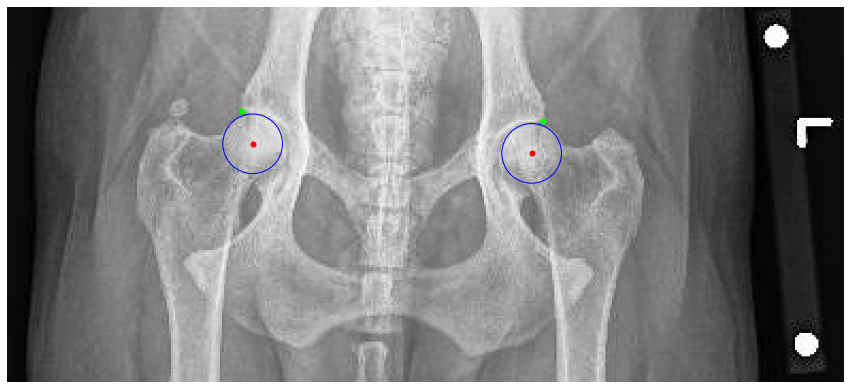

Processing /home/featurize/work/Dataset2/data/Testing/Images/314200.jpeg
center: [[[528 195]]

 [[240 163]]]
head: [[[237 127]]

 [[542 160]]]


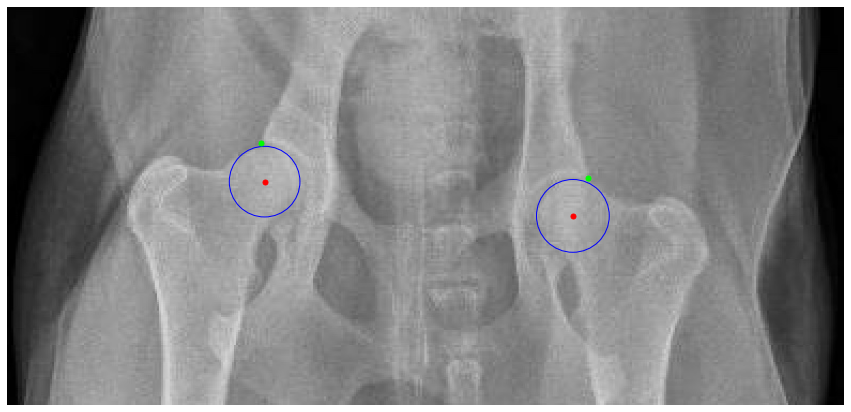

Processing /home/featurize/work/Dataset2/data/Testing/Images/351971.jpg
center: [[[ 386  318]]

 [[1089  330]]]
head: [[[ 357  222]]

 [[1139  237]]]


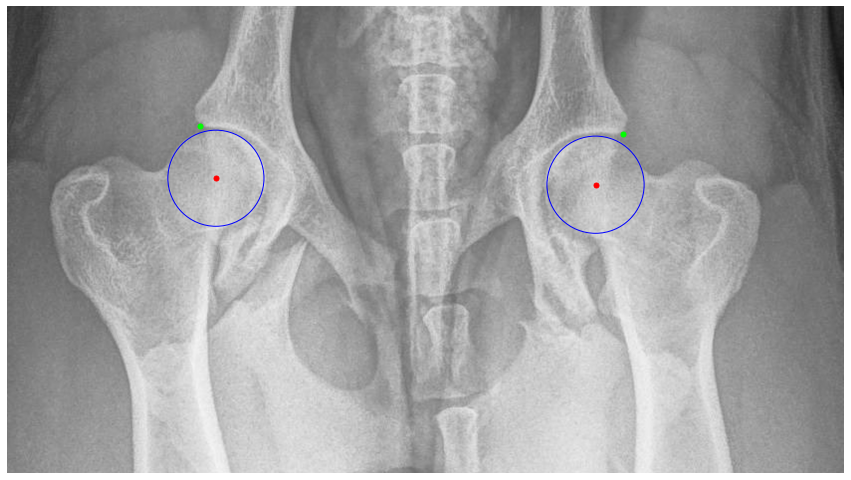

Processing /home/featurize/work/Dataset2/data/Testing/Images/339041.jpeg
center: [[[225 137]]

 [[516 136]]]
head: [[[224 106]]

 [[511 106]]]


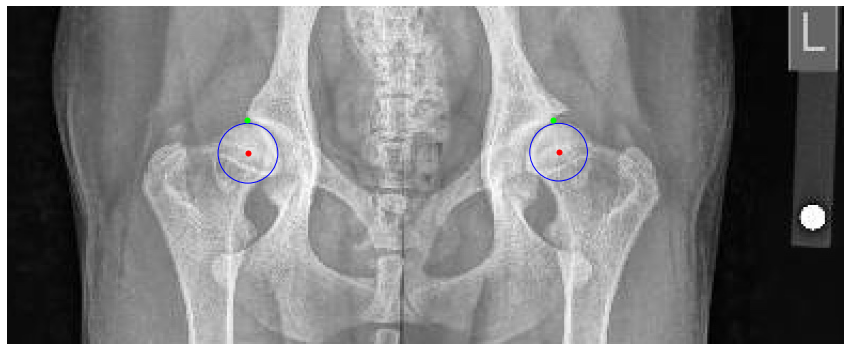

Processing /home/featurize/work/Dataset2/data/Testing/Images/332727.jpeg
center: [[[206 150]]

 [[474 170]]]
head: [[[486 138]]

 [[200 116]]]


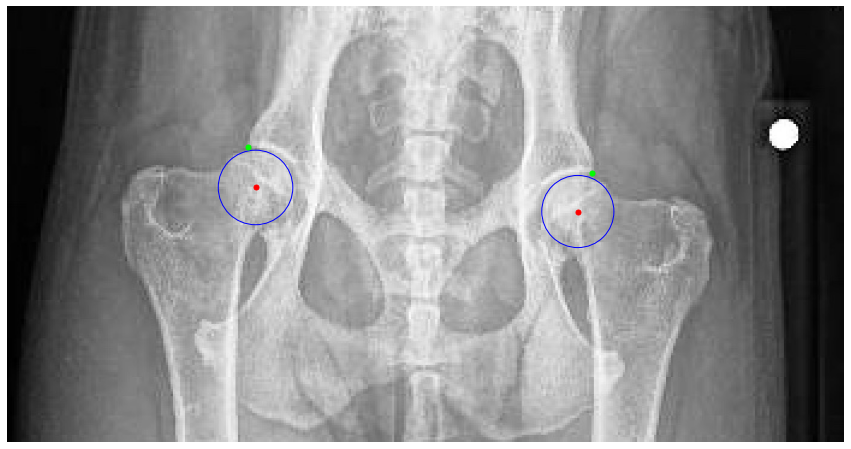

Processing /home/featurize/work/Dataset2/data/Testing/Images/351666.jpg
center: [[[ 375  365]]

 [[1253  364]]]
head: [[[ 353  263]]

 [[1277  267]]]


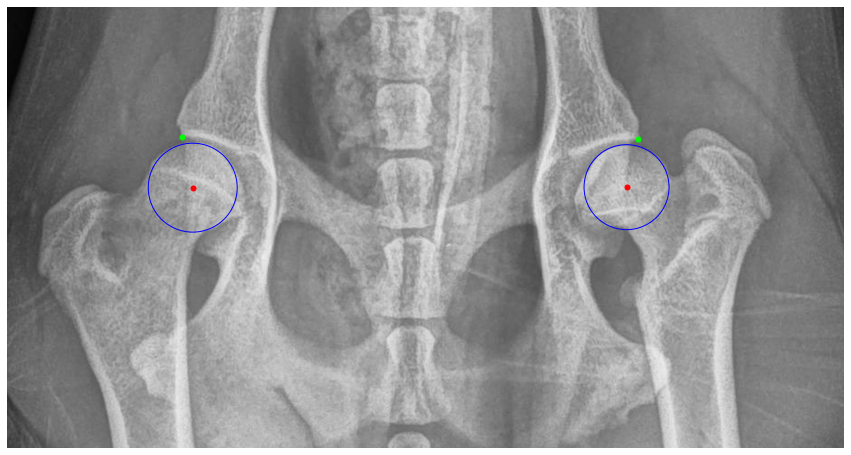

Processing /home/featurize/work/Dataset2/data/Testing/Images/351294.jpeg
center: [[[198 118]]

 [[452 109]]]
head: [[[189  87]]

 [[460  77]]]


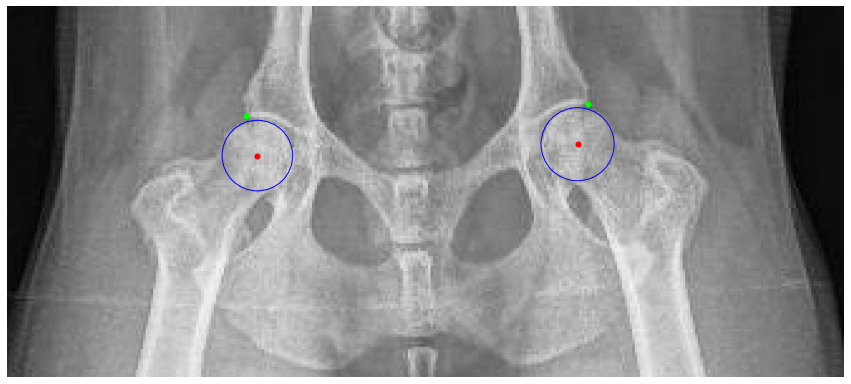

Processing /home/featurize/work/Dataset2/data/Testing/Images/288625.jpeg
center: [[[509 119]]

 [[262 106]]]
head: [[[253  76]]

 [[518  89]]]


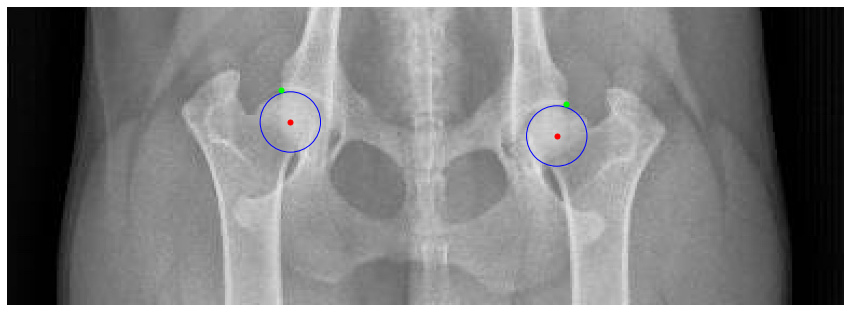

Processing /home/featurize/work/Dataset2/data/Testing/Images/357332.jpeg
center: [[[490 103]]

 [[222  98]]]
head: [[[209  67]]

 [[503  71]]]


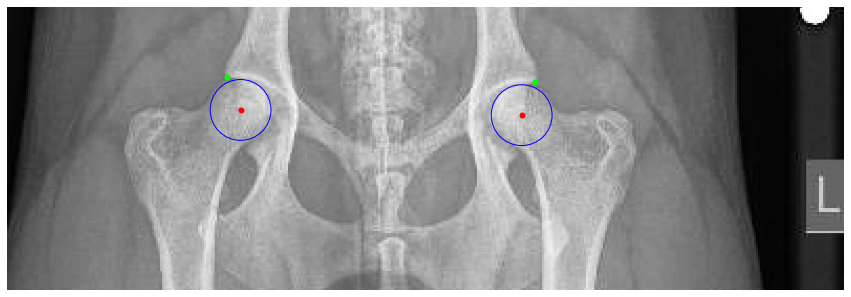

Processing /home/featurize/work/Dataset2/data/Testing/Images/345281.jpeg
center: [[[223 148]]

 [[501 142]]]
head: [[[510 109]]

 [[209 115]]]


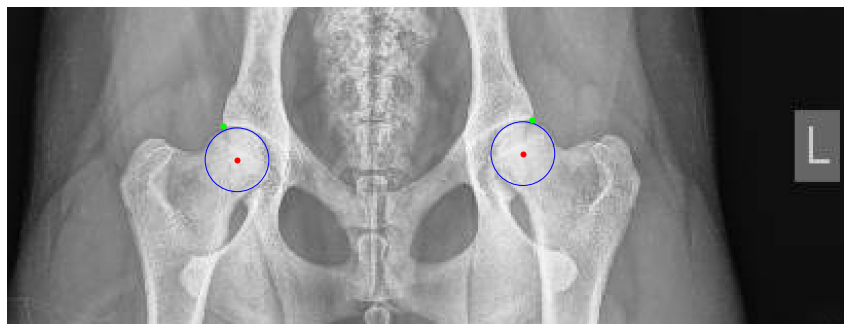

Processing /home/featurize/work/Dataset2/data/Testing/Images/364123.jpeg
center: [[[423  98]]

 [[164 104]]]
head: [[[150  73]]

 [[433  68]]]


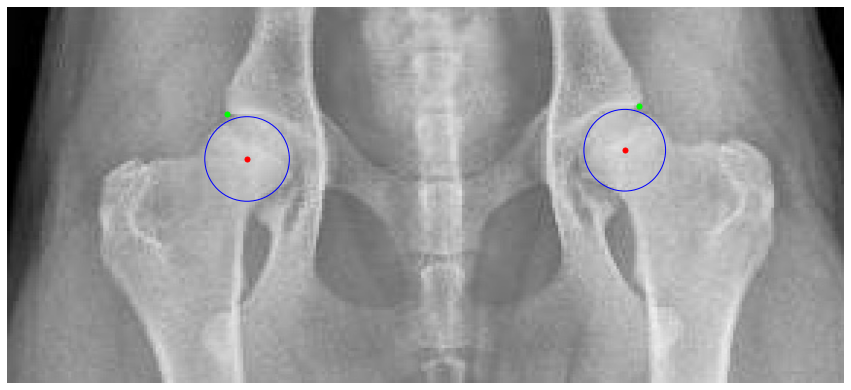

Processing /home/featurize/work/Dataset2/data/Testing/Images/332635.jpeg
center: [[[509 165]]

 [[273 154]]]
head: [[[268 124]]

 [[519 136]]]


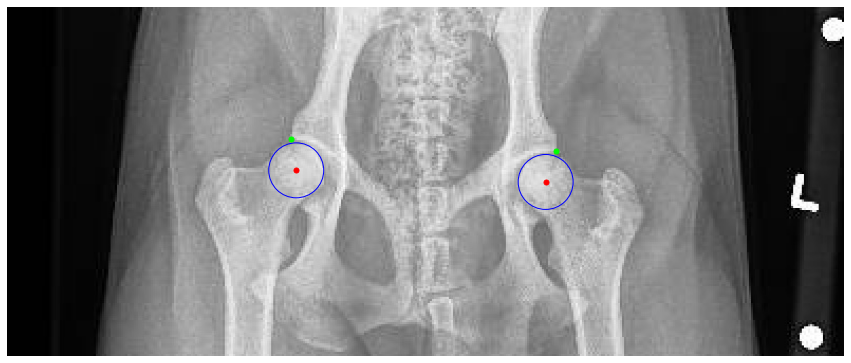

Processing /home/featurize/work/Dataset2/data/Testing/Images/355423.jpeg
center: [[[208 181]]

 [[533 201]]]
head: [[[198 142]]

 [[549 160]]]


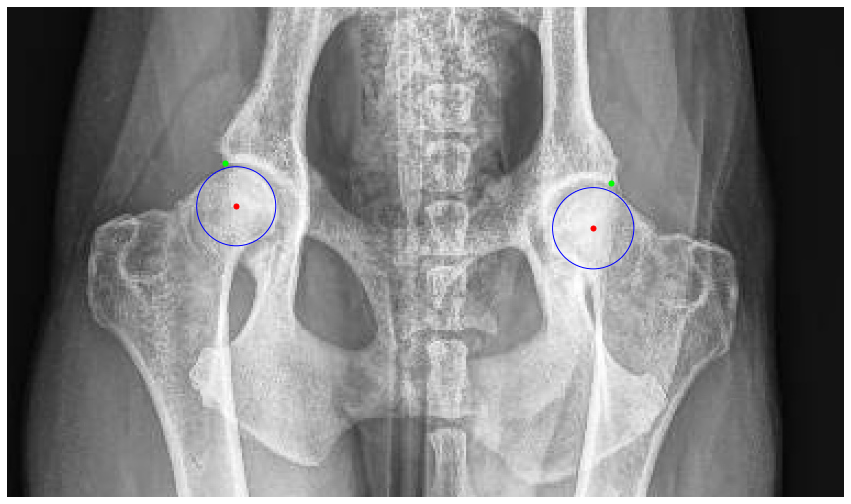

Processing /home/featurize/work/Dataset2/data/Testing/Images/360391.jpeg
center: [[[195 131]]

 [[526 137]]]
head: [[[194  97]]

 [[523 106]]]


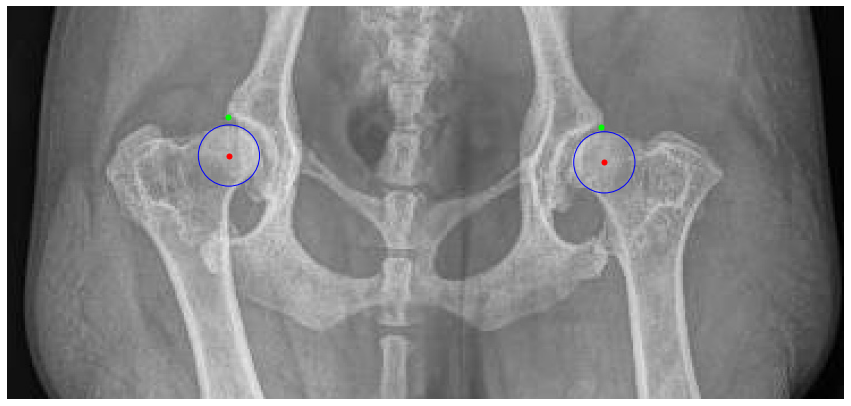

Processing /home/featurize/work/Dataset2/data/Testing/Images/366863.jpeg
center: [[[460  94]]

 [[192  96]]]
head: [[[468  61]]

 [[177  65]]]


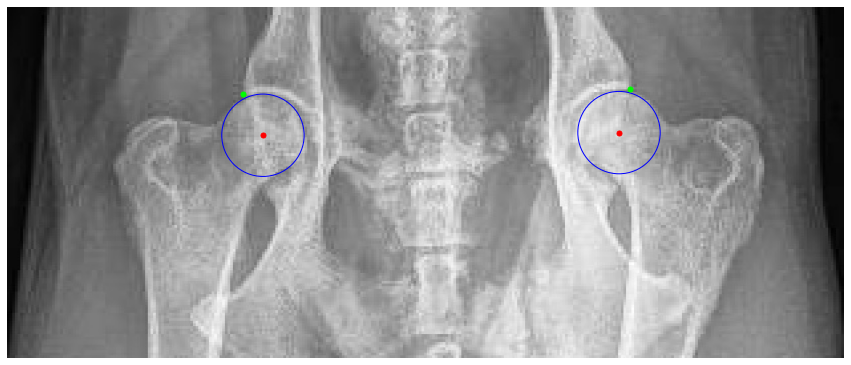

Processing /home/featurize/work/Dataset2/data/Testing/Images/353028.jpeg
center: [[[191 160]]

 [[491 147]]]
head: [[[180 127]]

 [[491 113]]]


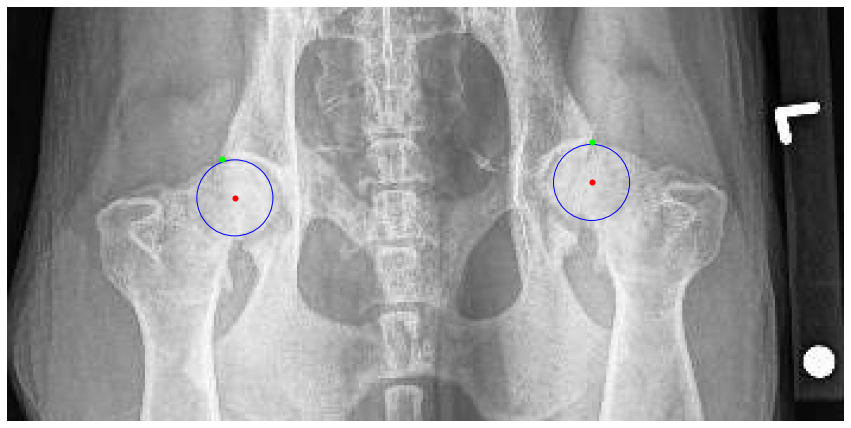

Processing /home/featurize/work/Dataset2/data/Testing/Images/358586.jpeg
center: [[[120  78]]

 [[332  80]]]
head: [[[335  56]]

 [[121  54]]]


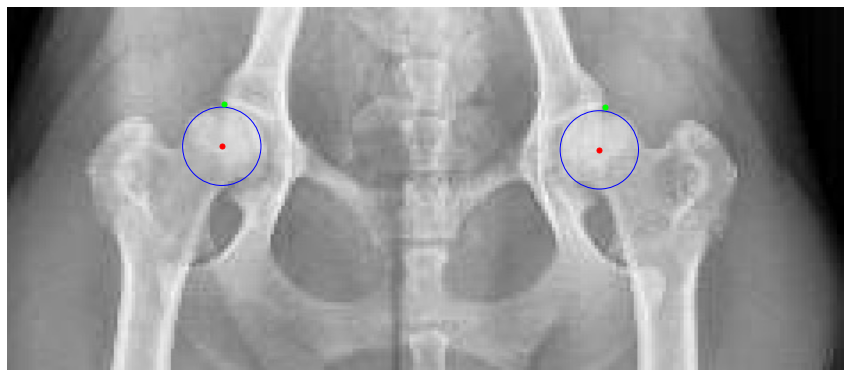

Processing /home/featurize/work/Dataset2/data/Testing/Images/357885.jpeg
center: [[[197 129]]

 [[483 133]]]
head: [[[490  99]]

 [[199  95]]]


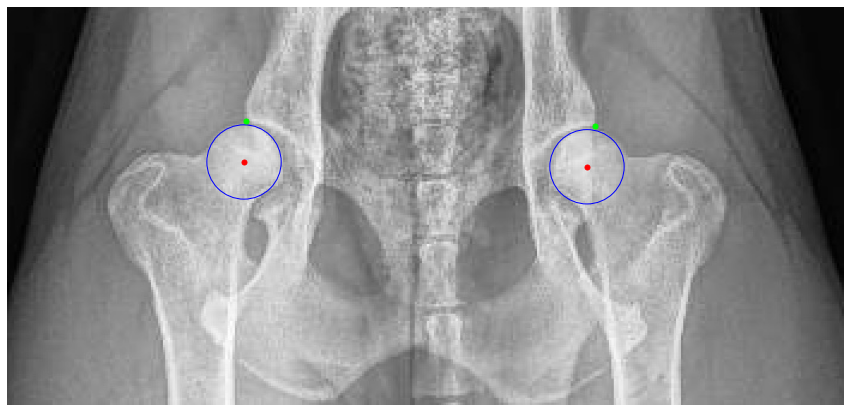

Processing /home/featurize/work/Dataset2/data/Testing/Images/360713.jpeg
center: [[[186 117]]

 [[498 118]]]
head: [[[196  88]]

 [[487  88]]]


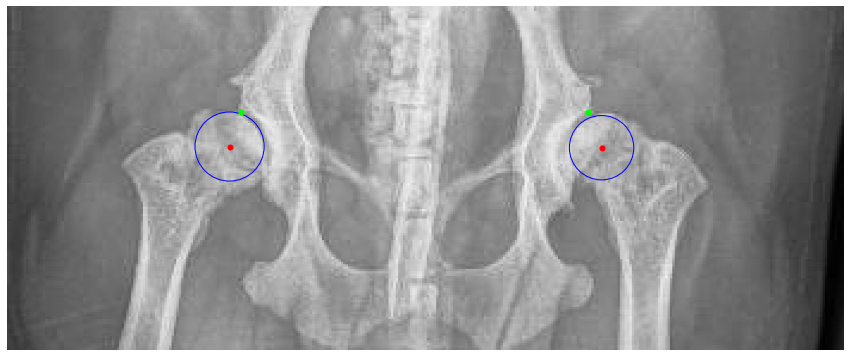

Processing /home/featurize/work/Dataset2/data/Testing/Images/355048.jpeg
center: [[[547 168]]

 [[214 146]]]
head: [[[536 135]]

 [[245 135]]]


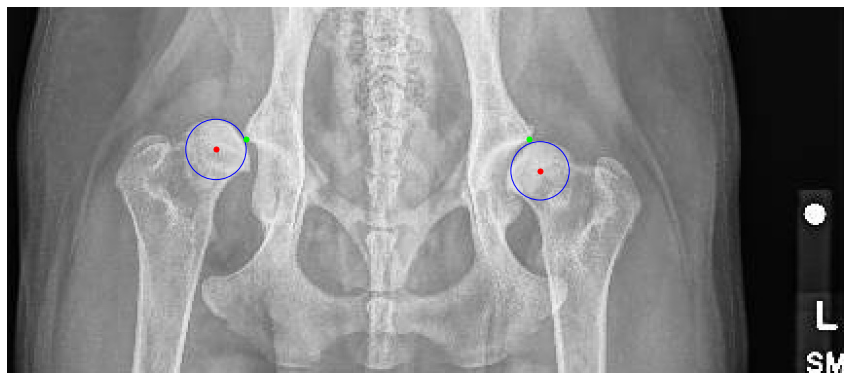

Processing /home/featurize/work/Dataset2/data/Testing/Images/328125.jpeg
center: [[[244 119]]

 [[470 134]]]
head: [[[241  91]]

 [[482 107]]]


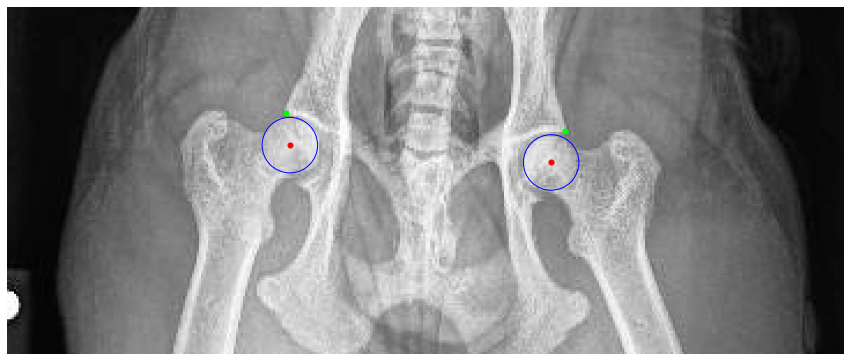

Processing /home/featurize/work/Dataset2/data/Testing/Images/366596.jpeg
center: [[[208 153]]

 [[617 154]]]
head: [[[201  99]]

 [[620 102]]]


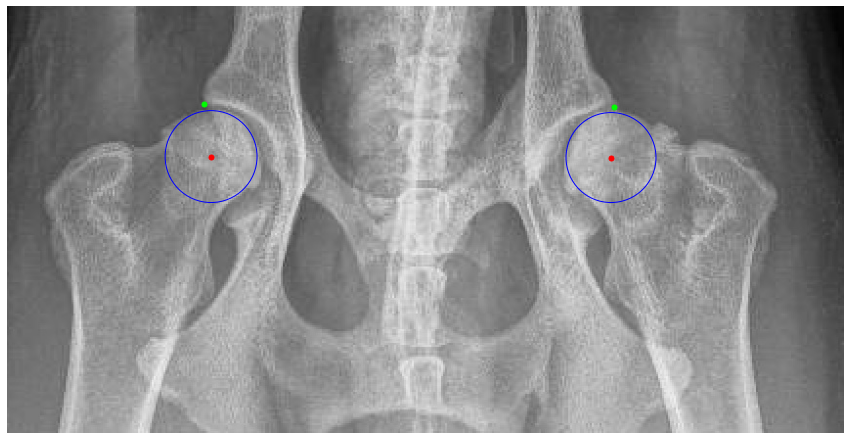

Processing /home/featurize/work/Dataset2/data/Testing/Images/274791.jpeg
center: [[[273 181]]

 [[543 195]]]
head: [[[265 148]]

 [[555 164]]]


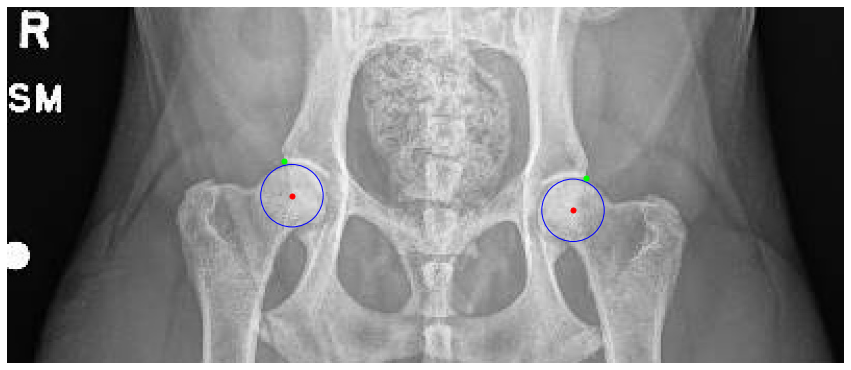

Processing /home/featurize/work/Dataset2/data/Testing/Images/361394.jpeg
center: [[[399  93]]

 [[145  95]]]
head: [[[407  59]]

 [[136  62]]]


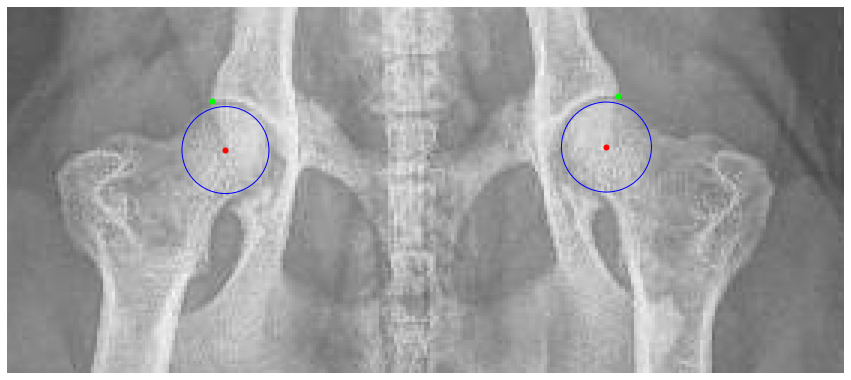

Processing /home/featurize/work/Dataset2/data/Testing/Images/355416.jpeg
center: [[[185 100]]

 [[486  95]]]
head: [[[493  61]]

 [[174  64]]]


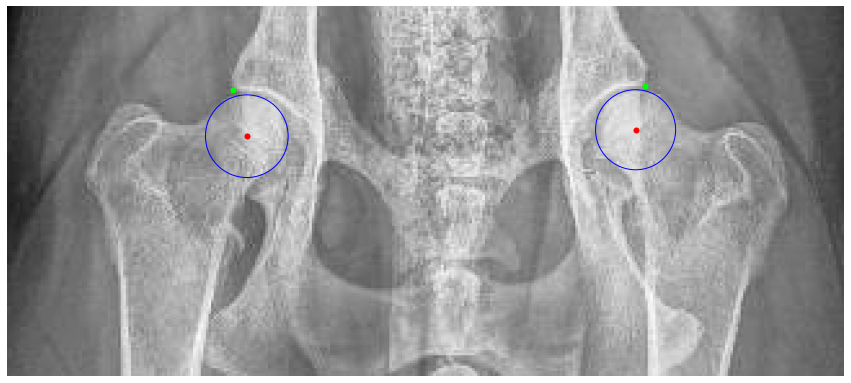

Processing /home/featurize/work/Dataset2/data/Testing/Images/361506.jpeg
center: [[[169 114]]

 [[489 114]]]
head: [[[173  81]]

 [[482  83]]]


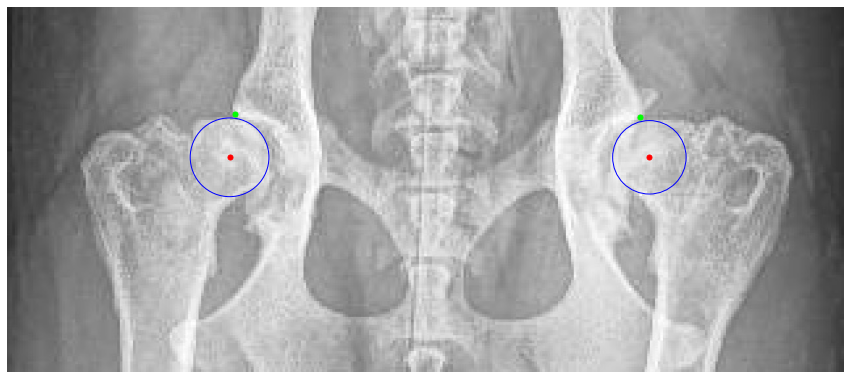

Processing /home/featurize/work/Dataset2/data/Testing/Images/354095.jpeg
center: [[[159 107]]

 [[438  77]]]
head: [[[144  78]]

 [[429  49]]]


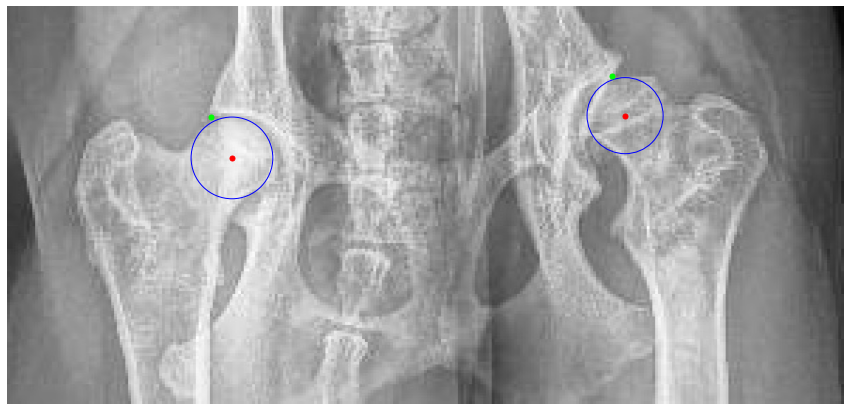

Processing /home/featurize/work/Dataset2/data/Testing/Images/331722.jpeg
center: [[[659 161]]

 [[363 186]]]
head: [[[348 152]]

 [[666 128]]]


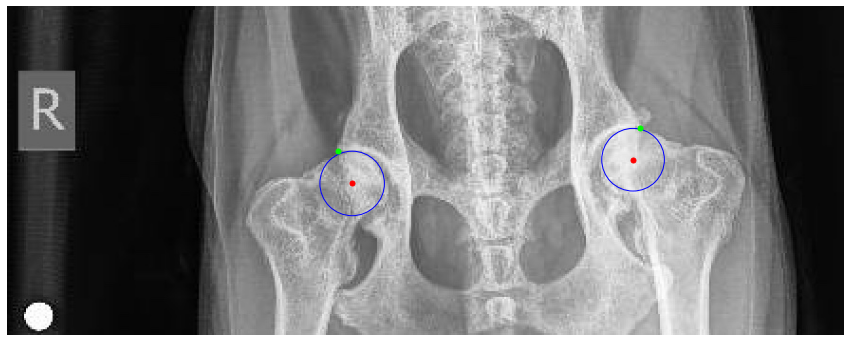

Processing /home/featurize/work/Dataset2/data/Testing/Images/353949.jpg
center: [[[1300  383]]

 [[ 360  298]]]
head: [[[1308  285]]

 [[ 398  217]]]


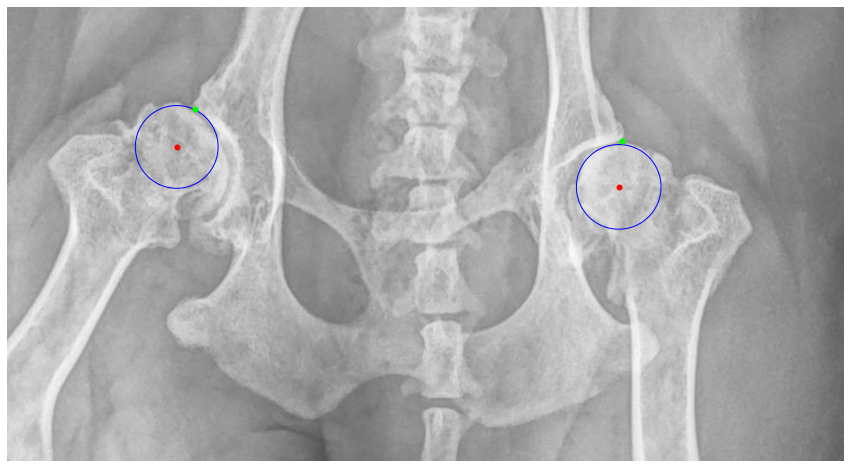

Processing /home/featurize/work/Dataset2/data/Testing/Images/351595.jpeg
center: [[[444 161]]

 [[180 137]]]
head: [[[458 130]]

 [[184 107]]]


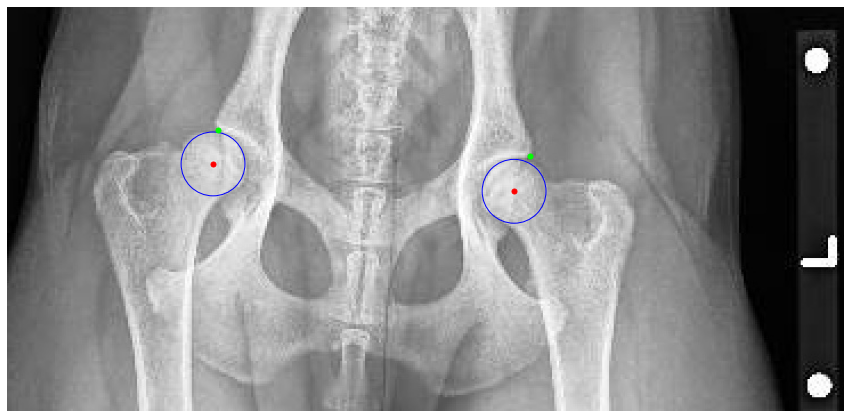

Processing /home/featurize/work/Dataset2/data/Testing/Images/349667.jpeg
center: [[[498 148]]

 [[220 136]]]
head: [[[214 101]]

 [[511 113]]]


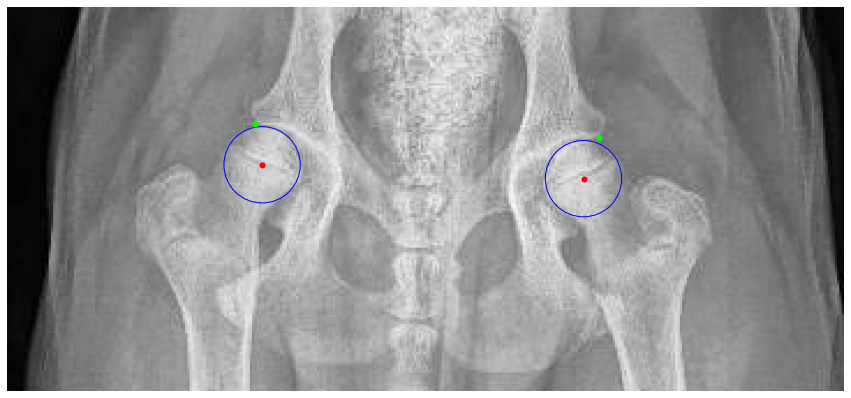

Processing /home/featurize/work/Dataset2/data/Testing/Images/353433.jpeg
center: [[[210 156]]

 [[520 155]]]
head: [[[197 117]]

 [[527 116]]]


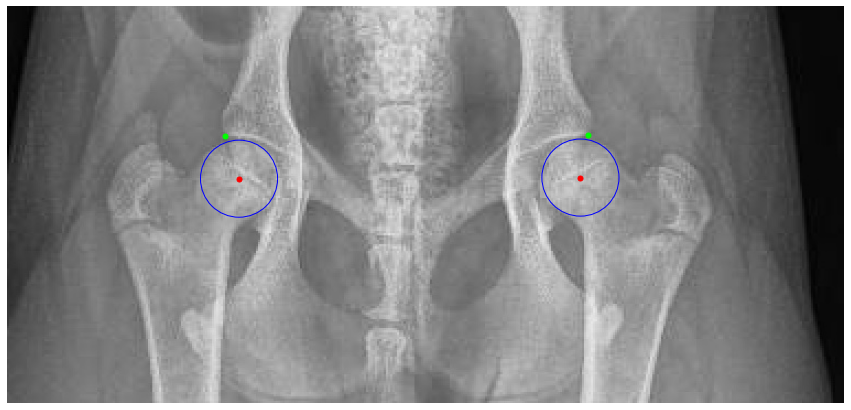

Processing /home/featurize/work/Dataset2/data/Testing/Images/325050.jpg
center: [[[1140  186]]

 [[ 392  230]]]
head: [[[1159   93]]

 [[ 362  138]]]


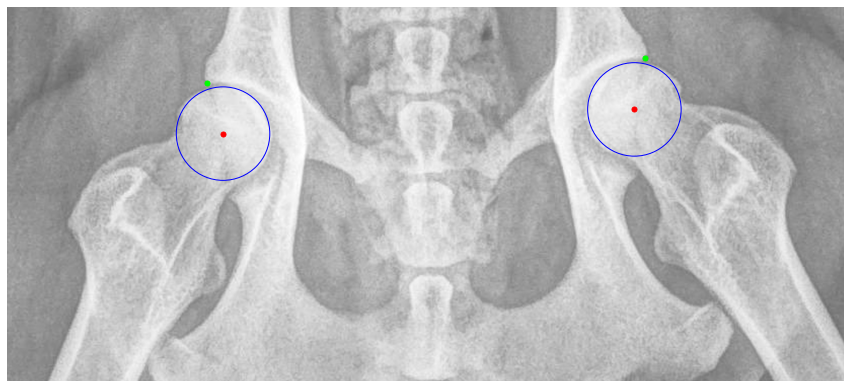

Processing /home/featurize/work/Dataset2/data/Testing/Images/347694.jpeg
center: [[[194 143]]

 [[505 166]]]
head: [[[200 111]]

 [[499 133]]]


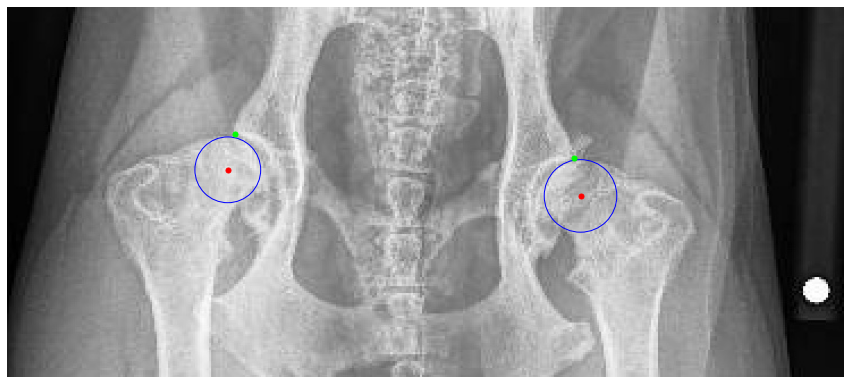

Processing /home/featurize/work/Dataset2/data/Testing/Images/354826.jpg
center: [[[1110  215]]

 [[ 419  266]]]
head: [[[ 393  186]]

 [[1116  132]]]


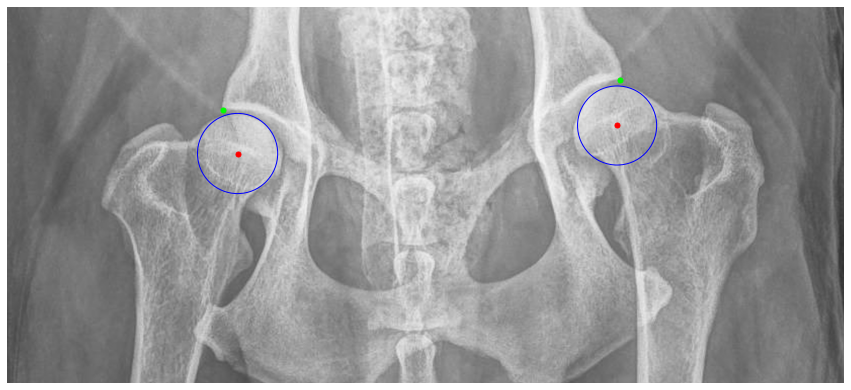

Processing /home/featurize/work/Dataset2/data/Testing/Images/346249.jpg
center: [[[1033  297]]

 [[ 347  236]]]
head: [[[ 314  154]]

 [[1061  214]]]


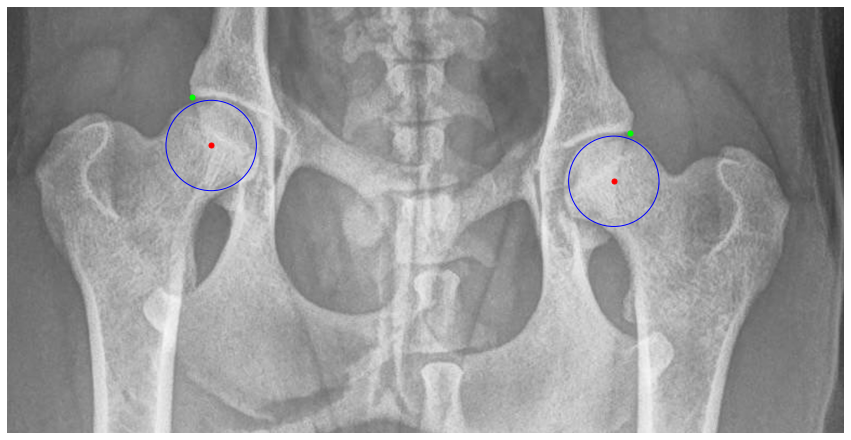

Processing /home/featurize/work/Dataset2/data/Testing/Images/357623.jpg
center: [[[1038  276]]

 [[ 364  301]]]
head: [[[1064  188]]

 [[ 325  214]]]


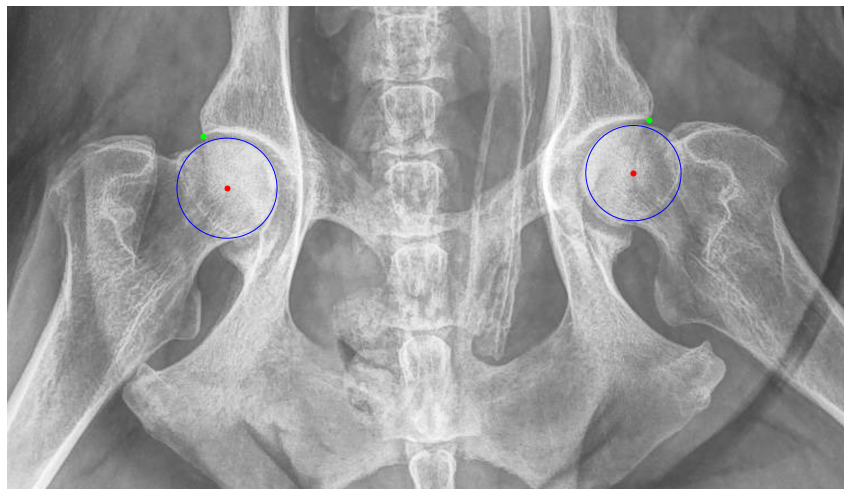

Processing /home/featurize/work/Dataset2/data/Testing/Images/357265.jpeg
center: [[[211 198]]

 [[538 208]]]
head: [[[204 160]]

 [[548 173]]]


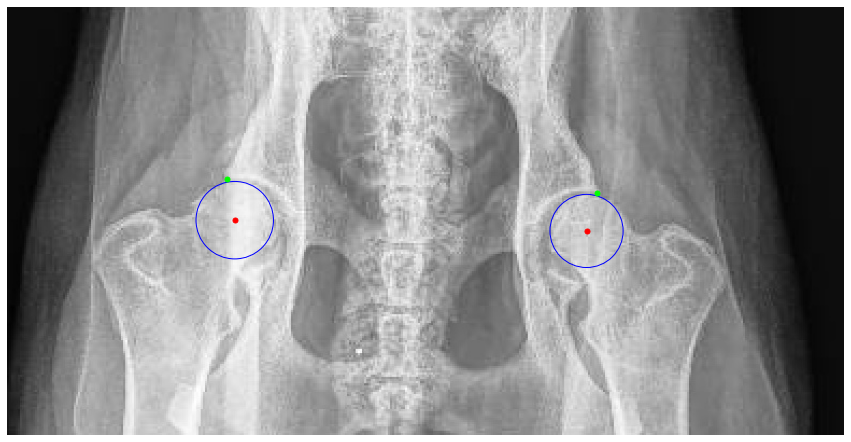

Processing /home/featurize/work/Dataset2/data/Testing/Images/353330.jpeg
center: [[[504 158]]

 [[192 133]]]
head: [[[511 124]]

 [[206 102]]]


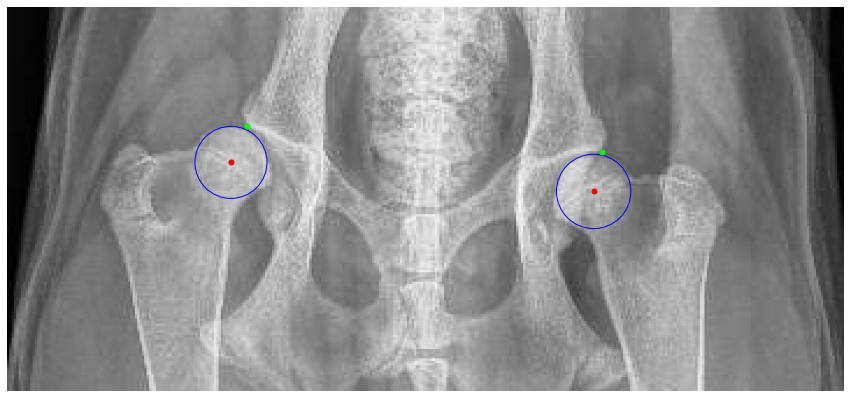

Processing /home/featurize/work/Dataset2/data/Testing/Images/363860.jpeg
center: [[[152 133]]

 [[471 151]]]
head: [[[485 115]]

 [[141  98]]]


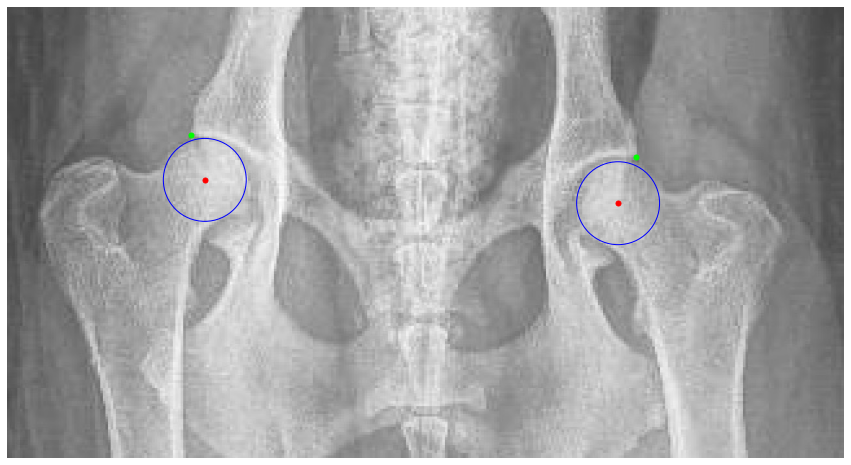

Processing /home/featurize/work/Dataset2/data/Testing/Images/325038.jpeg
center: [[[301 154]]

 [[580 155]]]
head: [[[291 121]]

 [[592 121]]]


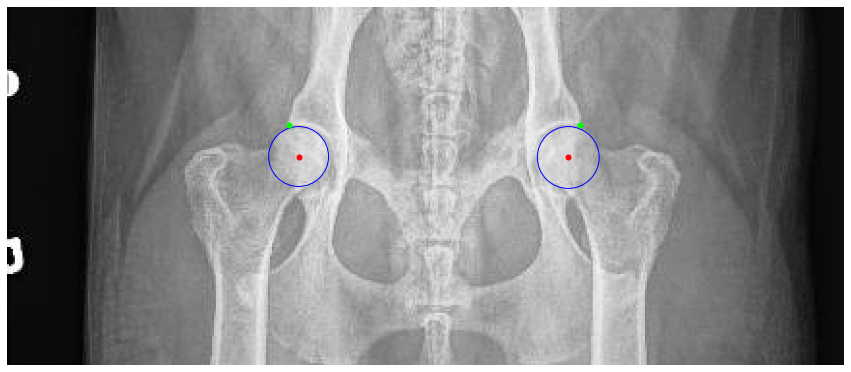

Processing /home/featurize/work/Dataset2/data/Testing/Images/357970.jpeg
center: [[[445 134]]

 [[193 121]]]
head: [[[454 104]]

 [[195  89]]]


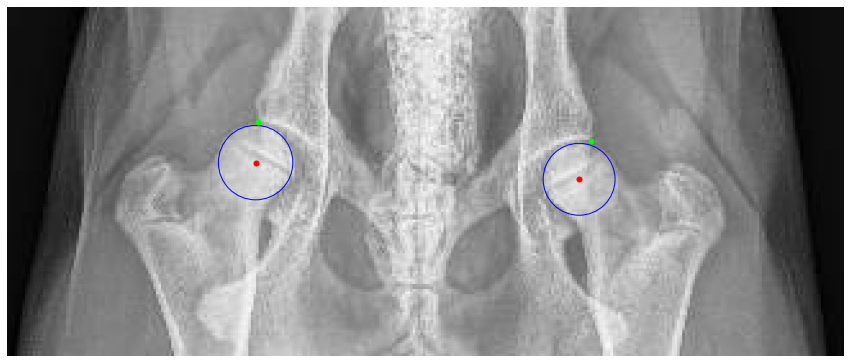

Processing /home/featurize/work/Dataset2/data/Testing/Images/268505.jpeg
center: [[[274  96]]

 [[567 138]]]
head: [[[266  59]]

 [[586 104]]]


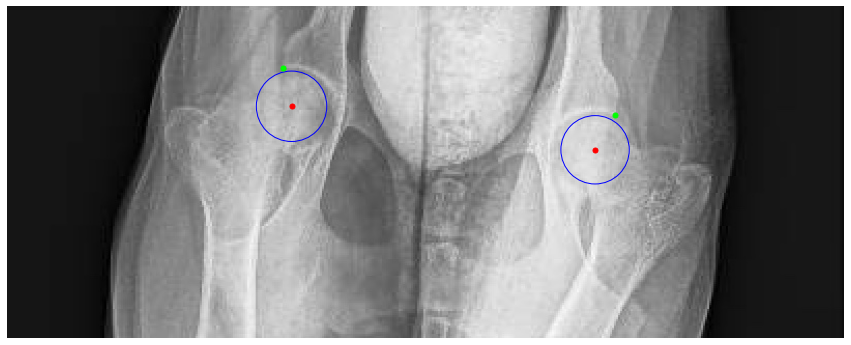

Processing /home/featurize/work/Dataset2/data/Testing/Images/349744.jpeg
center: [[[500 113]]

 [[246 106]]]
head: [[[238  77]]

 [[511  82]]]


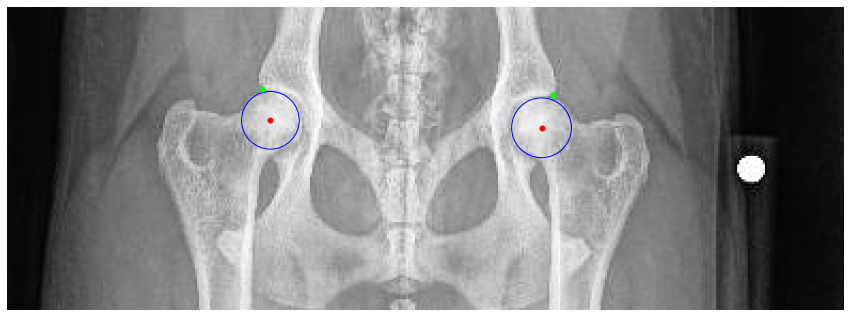

Processing /home/featurize/work/Dataset2/data/Testing/Images/351103.jpeg
center: [[[192 112]]

 [[431 109]]]
head: [[[186  82]]

 [[438  79]]]


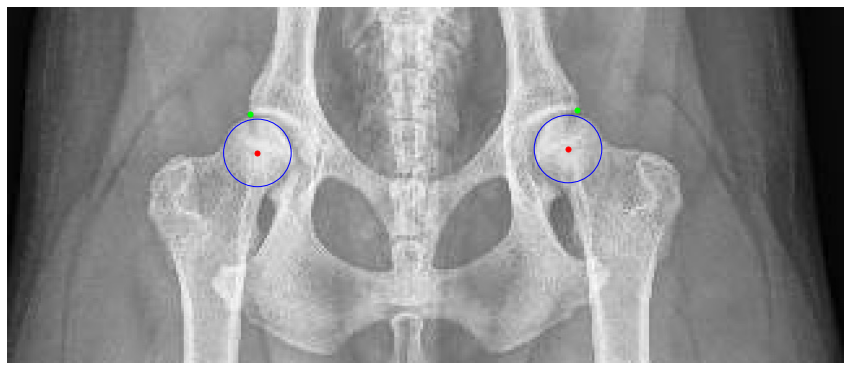

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg
center: [[[466 118]]

 [[216 129]]]
head: [[[206  98]]

 [[478  87]]]


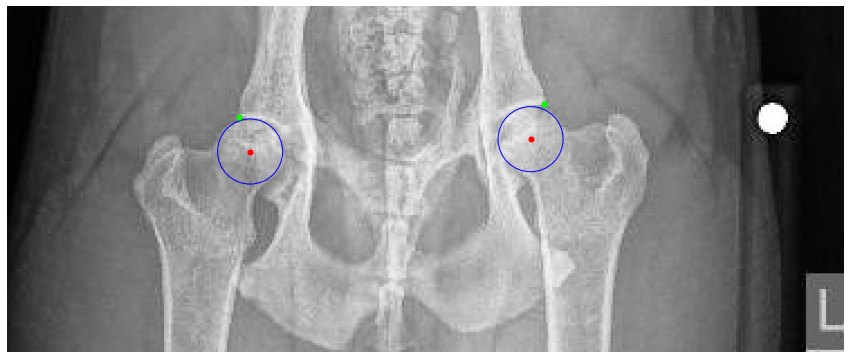

Processing /home/featurize/work/Dataset2/data/Testing/Images/352310.jpeg
center: [[[541 131]]

 [[197 134]]]
head: [[[544  93]]

 [[199  97]]]


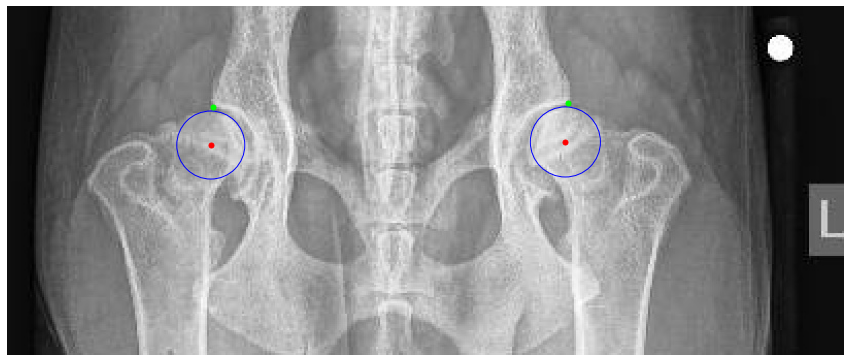

Processing /home/featurize/work/Dataset2/data/Testing/Images/364990.jpeg
center: [[[440 124]]

 [[171 113]]]
head: [[[164  76]]

 [[453  90]]]


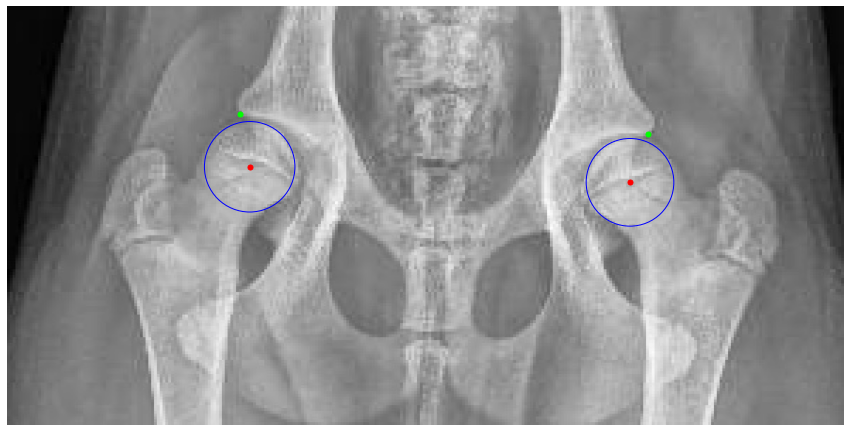

Processing /home/featurize/work/Dataset2/data/Testing/Images/361597.jpeg
center: [[[161 104]]

 [[387 105]]]
head: [[[400  79]]

 [[146  80]]]


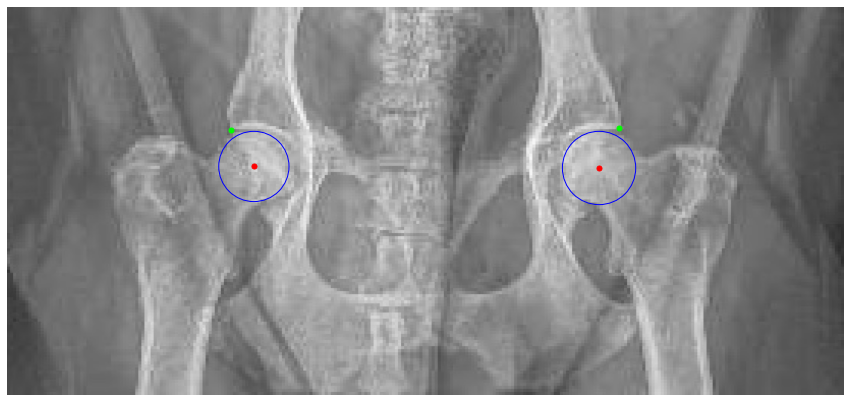

Processing /home/featurize/work/Dataset2/data/Testing/Images/360012.jpeg
center: [[[408 102]]

 [[142 100]]]
head: [[[416  72]]

 [[133  70]]]


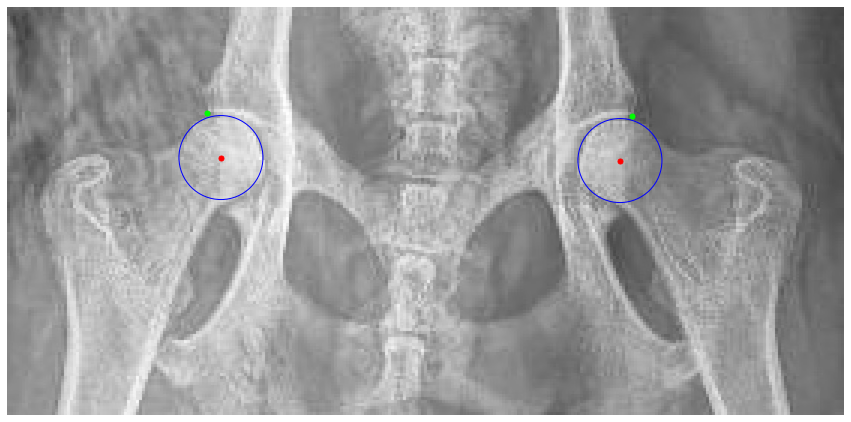

Processing /home/featurize/work/Dataset2/data/Testing/Images/329554.jpeg
center: [[[272 172]]

 [[565 207]]]
head: [[[266 138]]

 [[584 175]]]


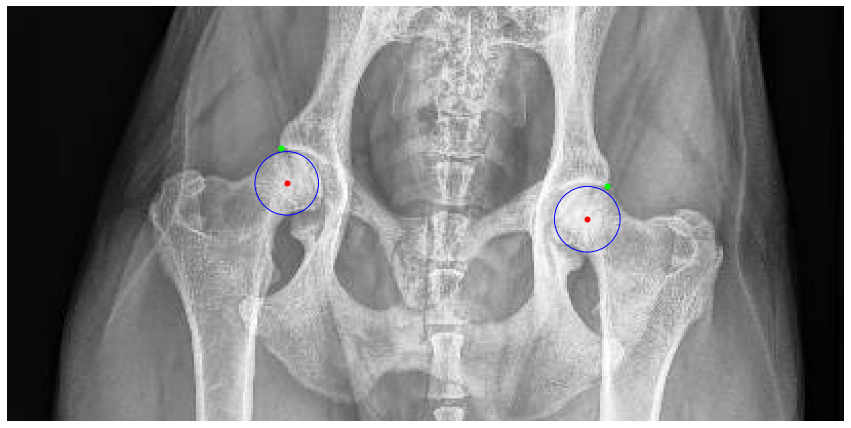

Processing /home/featurize/work/Dataset2/data/Testing/Images/357815.jpeg
center: [[[160 124]]

 [[408 120]]]
head: [[[416  91]]

 [[148  98]]]


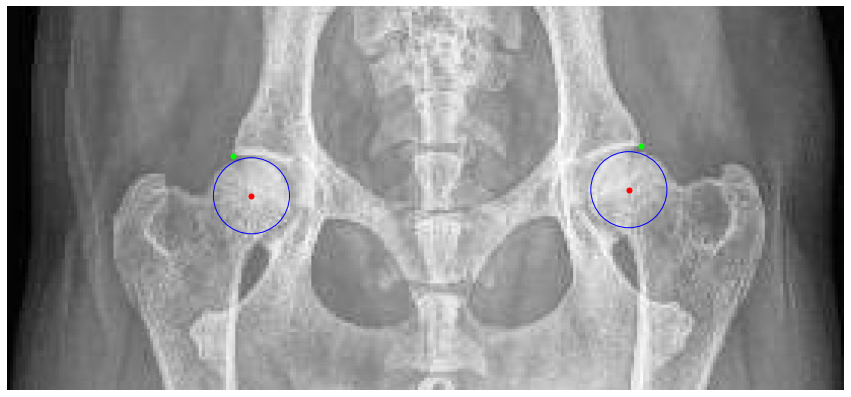

Processing /home/featurize/work/Dataset2/data/Testing/Images/354570.jpeg
center: [[[590 187]]

 [[294 176]]]
head: [[[284 140]]

 [[602 151]]]


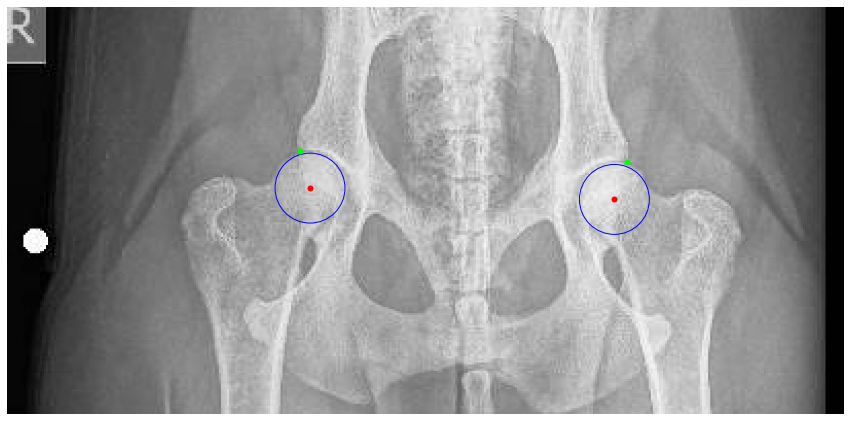

Processing /home/featurize/work/Dataset2/data/Testing/Images/361479.jpeg
center: [[[191 117]]

 [[483 124]]]
head: [[[178  82]]

 [[497  91]]]


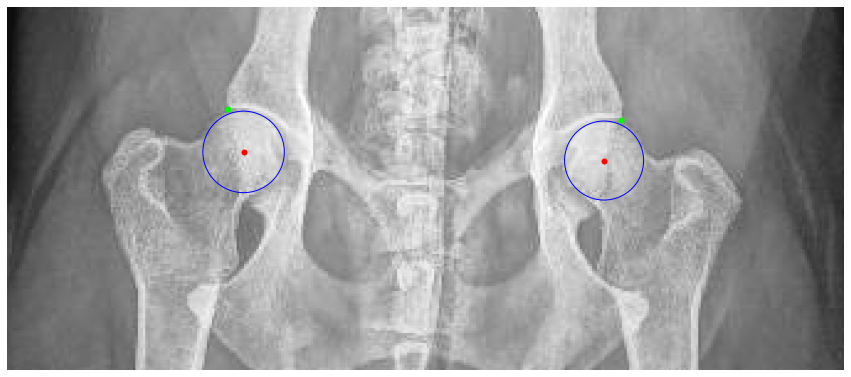

Processing /home/featurize/work/Dataset2/data/Testing/Images/357153.jpeg
center: [[[535 165]]

 [[240 162]]]
head: [[[548 129]]

 [[228 129]]]


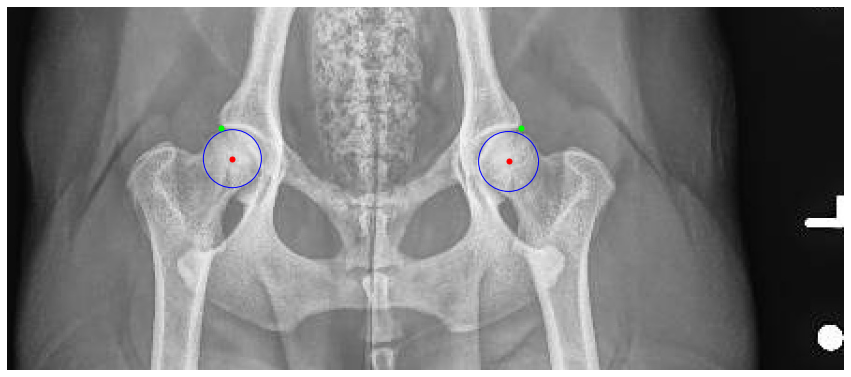

Processing /home/featurize/work/Dataset2/data/Testing/Images/308700.jpg
center: [[[ 347  248]]

 [[1049  309]]]
head: [[[ 336  169]]

 [[1079  230]]]


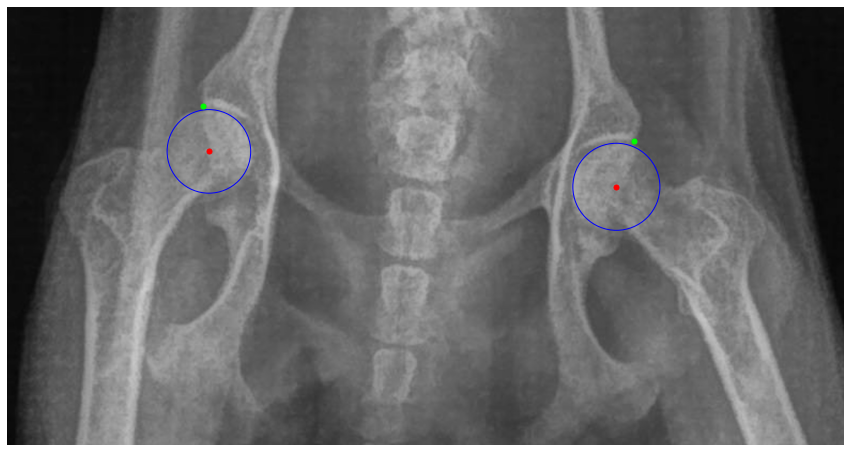

Processing /home/featurize/work/Dataset2/data/Testing/Images/361233.jpeg
center: [[[212 113]]

 [[498 137]]]
head: [[[508 103]]

 [[205  79]]]


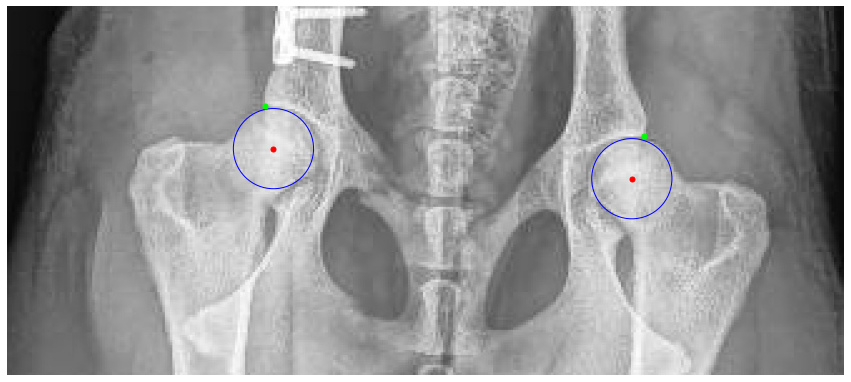

Processing /home/featurize/work/Dataset2/data/Testing/Images/357274.jpeg
center: [[[431 120]]

 [[157 104]]]
head: [[[441  90]]

 [[180  80]]]


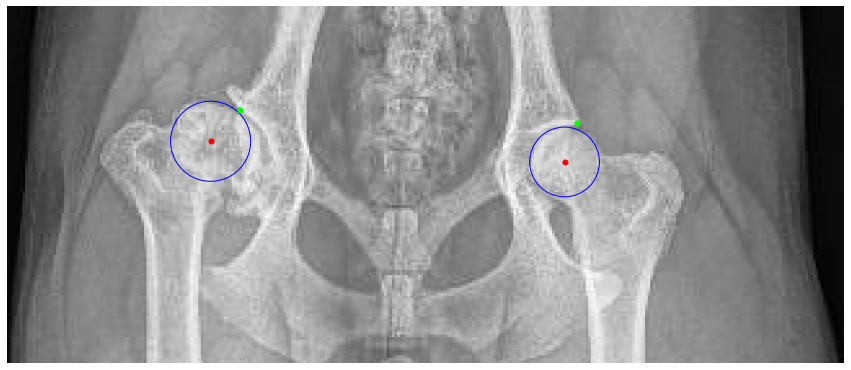

Processing /home/featurize/work/Dataset2/data/Testing/Images/330817.jpeg
center: [[[170 122]]

 [[480 134]]]
head: [[[183  90]]

 [[472  99]]]


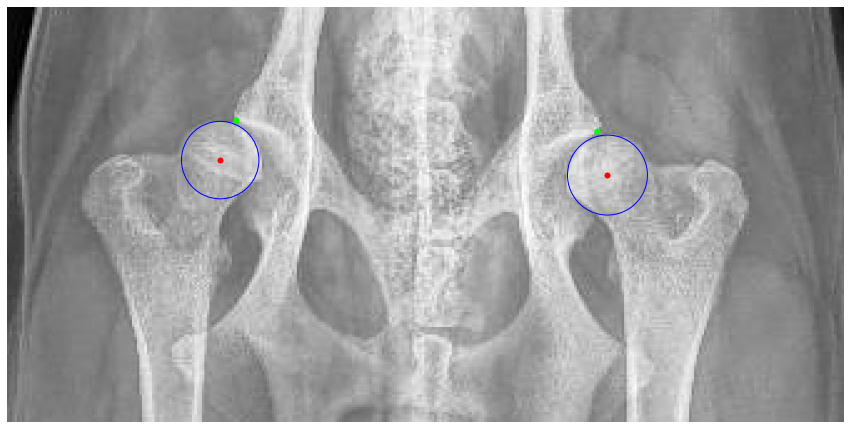

Processing /home/featurize/work/Dataset2/data/Testing/Images/359477.jpeg
center: [[[218  91]]

 [[486 106]]]
head: [[[208  58]]

 [[499  74]]]


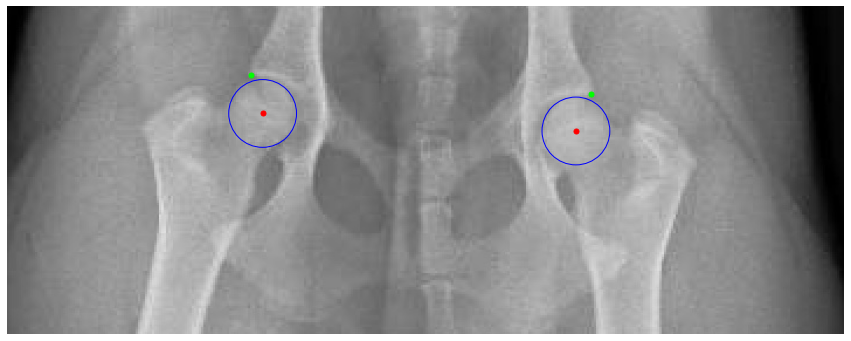

Processing /home/featurize/work/Dataset2/data/Testing/Images/320802.jpeg
center: [[[293 154]]

 [[595 152]]]
head: [[[286 118]]

 [[601 118]]]


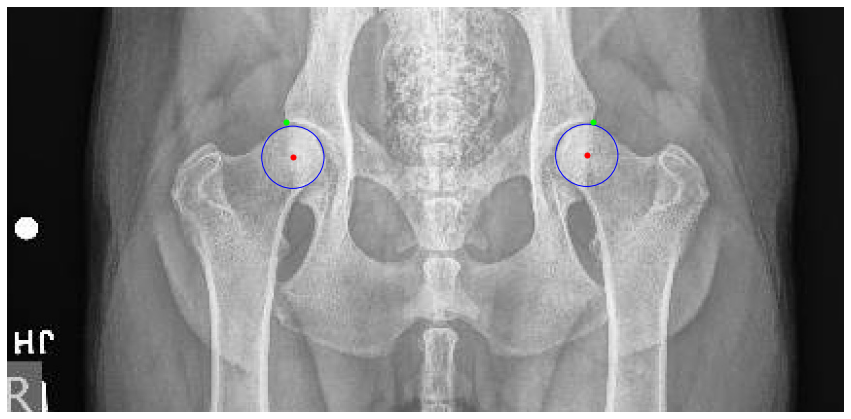

Processing /home/featurize/work/Dataset2/data/Testing/Images/362005.jpeg
center: [[[173 103]]

 [[425  94]]]
head: [[[427  65]]

 [[164  73]]]


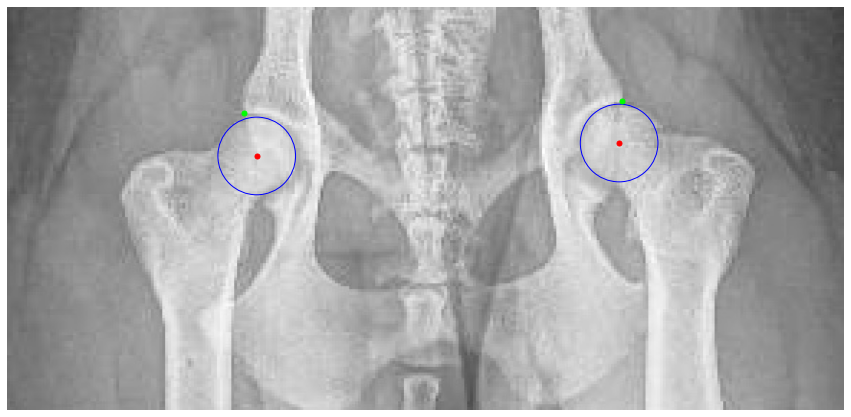

Processing /home/featurize/work/Dataset2/data/Testing/Images/362215.jpeg
center: [[[468 102]]

 [[196 116]]]
head: [[[184  77]]

 [[476  63]]]


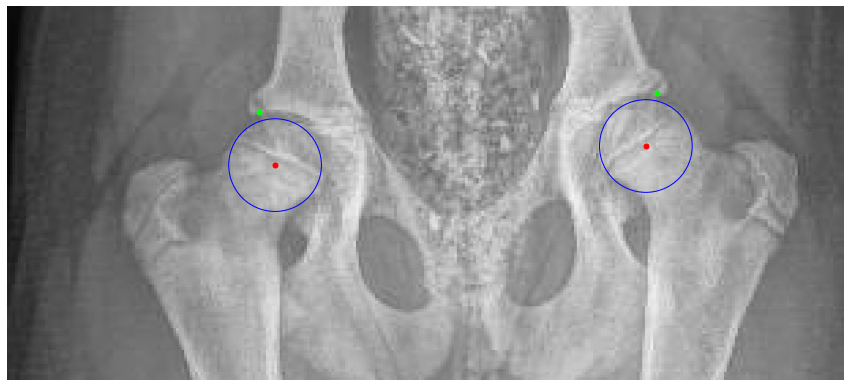

Processing /home/featurize/work/Dataset2/data/Testing/Images/351008.jpeg
center: [[[143 124]]

 [[393 107]]]
head: [[[138  88]]

 [[390  72]]]


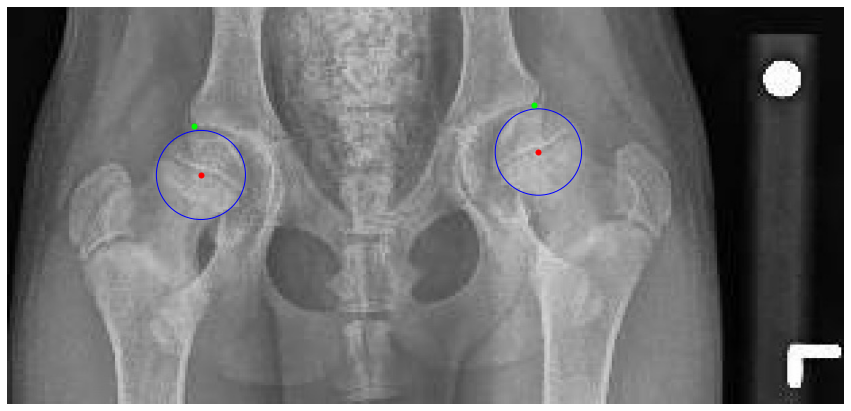

Processing /home/featurize/work/Dataset2/data/Testing/Images/356989.jpeg
center: [[[215 118]]

 [[518 112]]]
head: [[[223  91]]

 [[507  87]]]


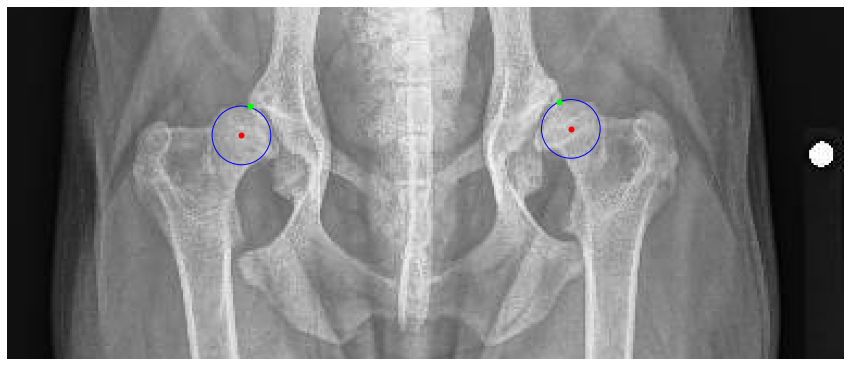

Processing /home/featurize/work/Dataset2/data/Testing/Images/331046.jpeg
center: [[[531 162]]

 [[212 168]]]
head: [[[197 132]]

 [[545 125]]]


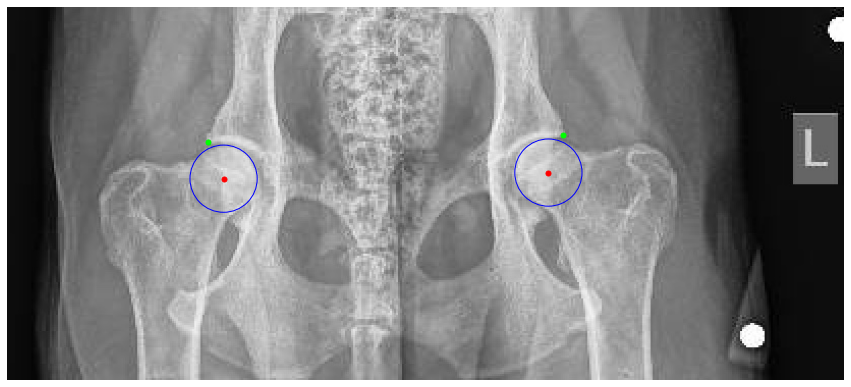

Processing /home/featurize/work/Dataset2/data/Testing/Images/324194.jpeg
center: [[[487 147]]

 [[218 158]]]
head: [[[500 112]]

 [[203 124]]]


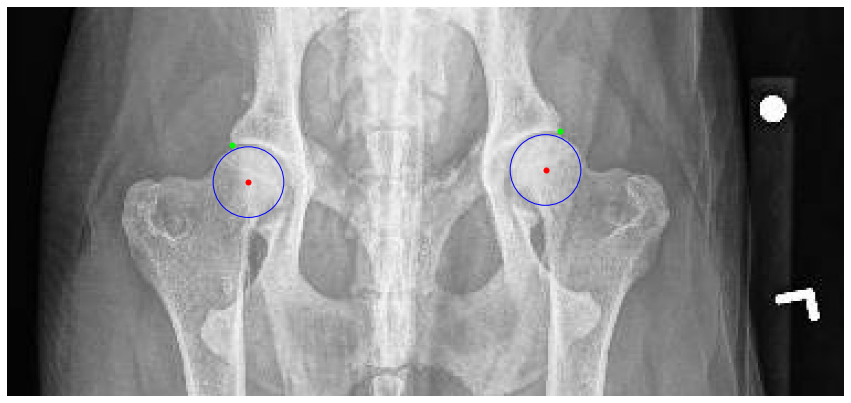

Processing /home/featurize/work/Dataset2/data/Testing/Images/342636.jpeg
center: [[[218 141]]

 [[483 141]]]
head: [[[230 118]]

 [[469 119]]]


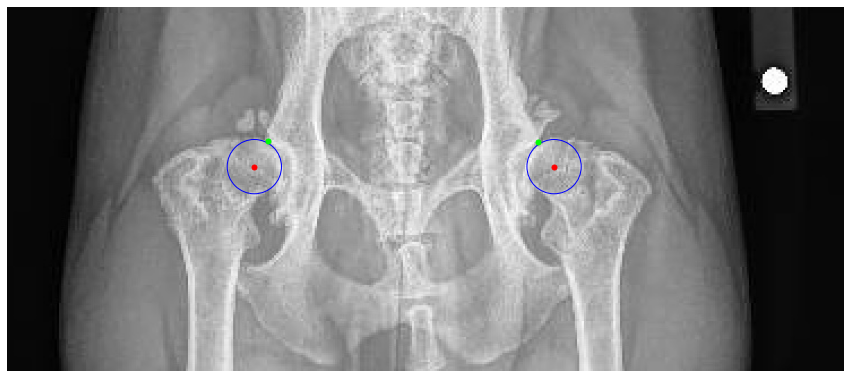

Processing /home/featurize/work/Dataset2/data/Testing/Images/361122.jpg
center: [[[1307  273]]

 [[ 359  156]]]
head: [[[1248  196]]

 [[ 464  141]]]


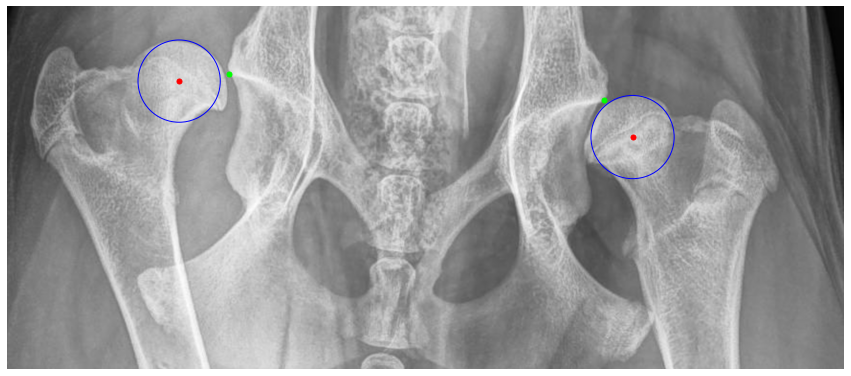

Processing /home/featurize/work/Dataset2/data/Testing/Images/363424.jpeg
center: [[[458 103]]

 [[189 108]]]
head: [[[178  77]]

 [[466  70]]]


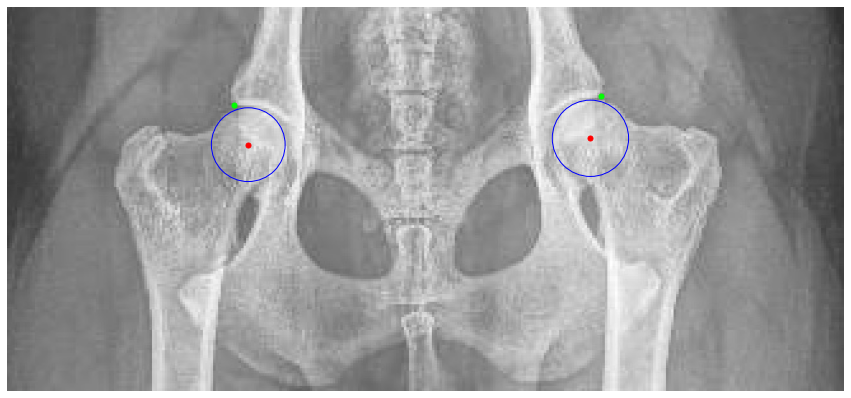

Processing /home/featurize/work/Dataset2/data/Testing/Images/351181.jpeg
center: [[[190 101]]

 [[458  87]]]
head: [[[192  71]]

 [[450  58]]]


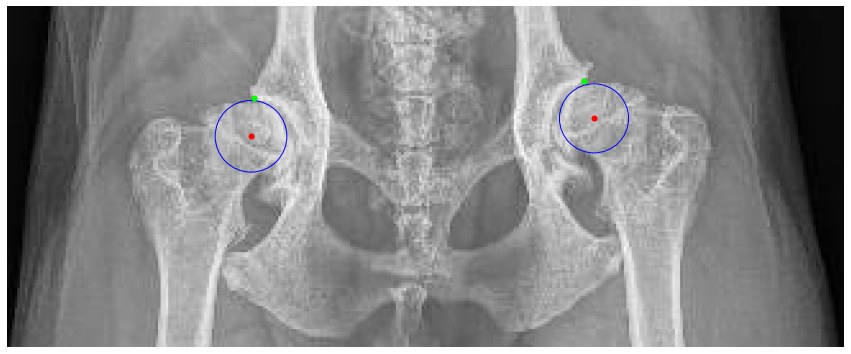

Processing /home/featurize/work/Dataset2/data/Testing/Images/282434.jpeg
center: [[[256 122]]

 [[526 128]]]
head: [[[535  94]]

 [[248  87]]]


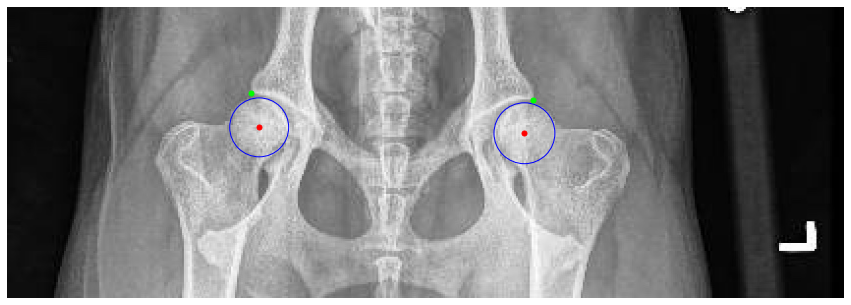

Processing /home/featurize/work/Dataset2/data/Testing/Images/281142.jpeg
center: [[[256 123]]

 [[595 135]]]
head: [[[586 102]]

 [[272  92]]]


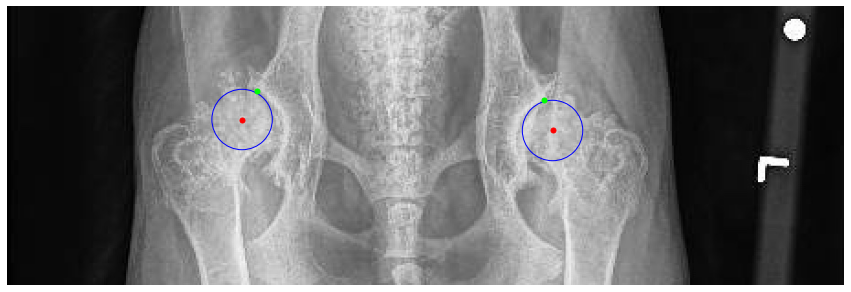

Processing /home/featurize/work/Dataset2/data/Testing/Images/359798.jpeg
center: [[[369 109]]

 [[142  88]]]
head: [[[379  81]]

 [[138  60]]]


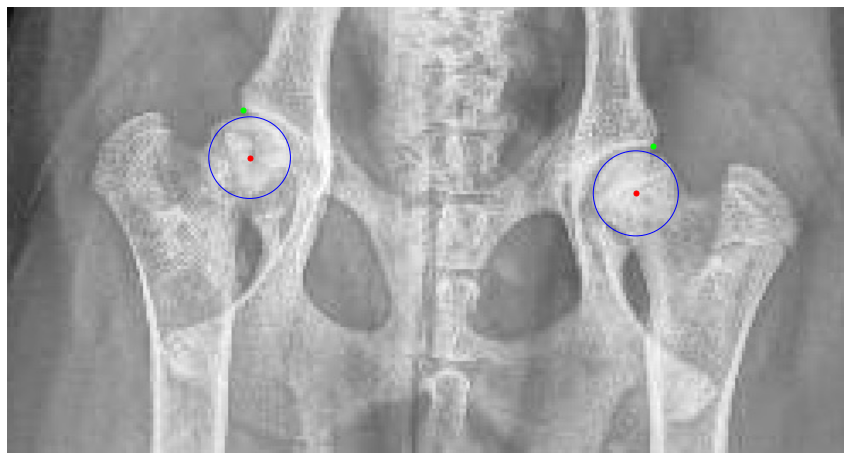

Processing /home/featurize/work/Dataset2/data/Testing/Images/293062.jpeg
center: [[[456 139]]

 [[199 121]]]
head: [[[189  89]]

 [[470 107]]]


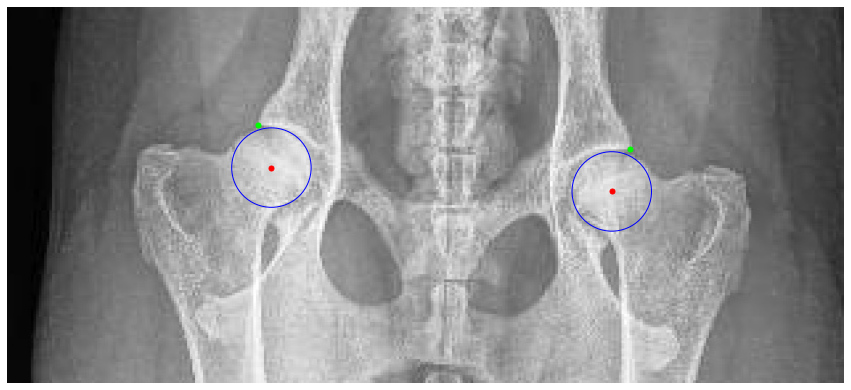

Processing /home/featurize/work/Dataset2/data/Testing/Images/308131.jpeg
center: [[[291 140]]

 [[587 133]]]
head: [[[596  96]]

 [[277 104]]]


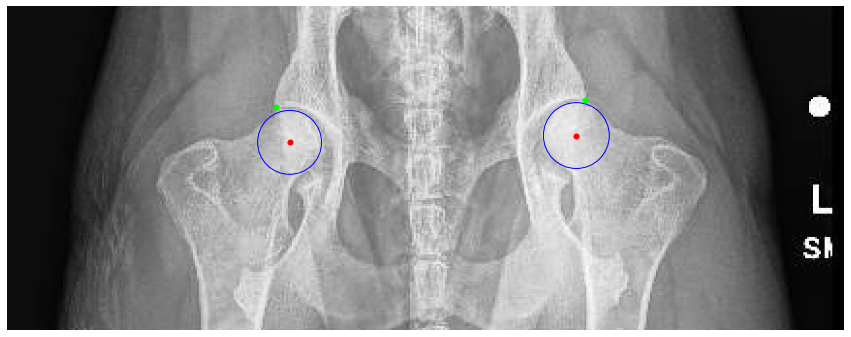

Processing /home/featurize/work/Dataset2/data/Testing/Images/332903.jpeg
center: [[[306 173]]

 [[552 169]]]
head: [[[299 146]]

 [[559 140]]]


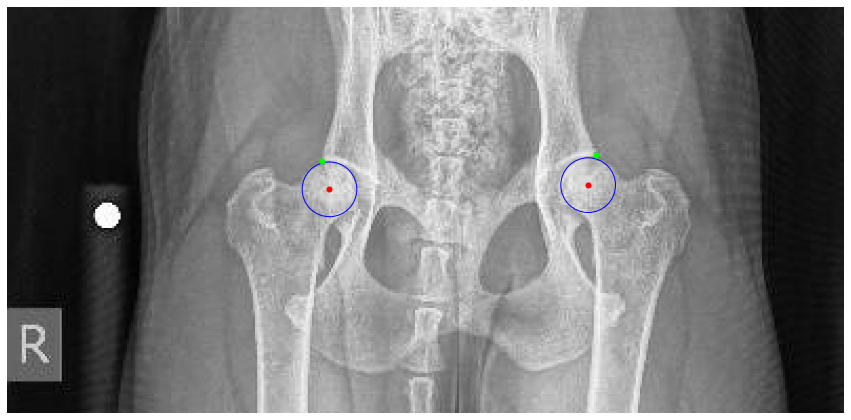

In [9]:
img_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

colors = [
    (255, 0, 0),    # 红色
    (0, 255, 0),    # 绿色
    (0, 0, 255),    # 蓝色
    (255, 255, 0),  # 黄色
]

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    ## center
    detect_result_center = inference_detector(detector, image_path)
    
    CONF_THRES = 0.39

    pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
    bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
    bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > CONF_THRES)]
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
    
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        
        try:
            data_samples_center = merge_data_samples(pose_results_center)
            center = data_samples_center.pred_instances.keypoints.astype('int')
            print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
                
    ## head   
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_head = inference_detector(detector2, image_path)
    
    CONF_THRES = 0.46

    pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
    bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
    bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > CONF_THRES)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
        
        try:
            data_samples_head = merge_data_samples(pose_results_head)
            head = data_samples_head.pred_instances.keypoints.astype('int')
            print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_center) > 0:
        for idx, bbox in enumerate(bboxes_center):
            keypoint = center[idx]
            #rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
            #ax.add_patch(rect)
            
            
            # 绘制关键点
            
            for x, y in keypoint:
                center_x = x
                center_y = y
                radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)

    # 绘制头部关键点
    if len(bboxes_head) > 0:
        for idx, bbox in enumerate(bboxes_head):
            keypoint = head[idx]
            for x, y in keypoint:
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)
    
    plt.axis('off')
    plt.show()

In [12]:
## Predict
def predict_and_plot(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.39, conf_thres_head=0.46):
    print(f'Processing {image_path}')
    image = imread(image_path)

    colors = [
        (255, 0, 0),    # 红色
        (0, 255, 0),    # 绿色
        (0, 0, 255),    # 蓝色
        (255, 255, 0),  # 黄色
    ]

    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

    ## center
    detect_result_center = inference_detector(detector, image_path)

    pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
    bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
    bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)

        try:
            data_samples_center = merge_data_samples(pose_results_center)
            center = data_samples_center.pred_instances.keypoints.astype('int')
            #print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    ## head   
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_head = inference_detector(detector2, image_path)

    pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
    bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
    bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)

        try:
            data_samples_head = merge_data_samples(pose_results_head)
            head = data_samples_head.pred_instances.keypoints.astype('int')
            #print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_center) > 0:
        for idx, bbox in enumerate(bboxes_center):
            keypoint = center[idx]
            for x, y in keypoint:
                center_x = x
                center_y = y
                radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)

    # 
    if len(bboxes_head) > 0:
        for idx, bbox in enumerate(bboxes_head):
            keypoint = head[idx]
            for x, y in keypoint:
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)

    plt.axis('off')
    plt.show()

Processing /home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg


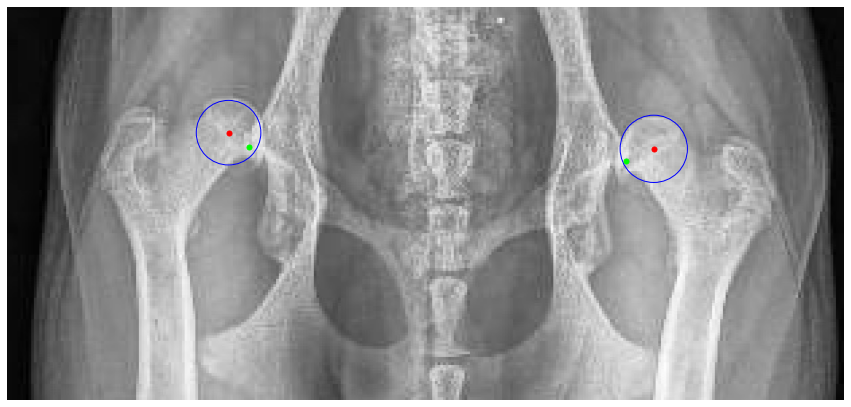

In [18]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg'
predict_and_plot(image_path, detector, detector2, pose_estimator, pose_estimator2, 
                 conf_thres_center=0.32, conf_thres_head=0.2)

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg


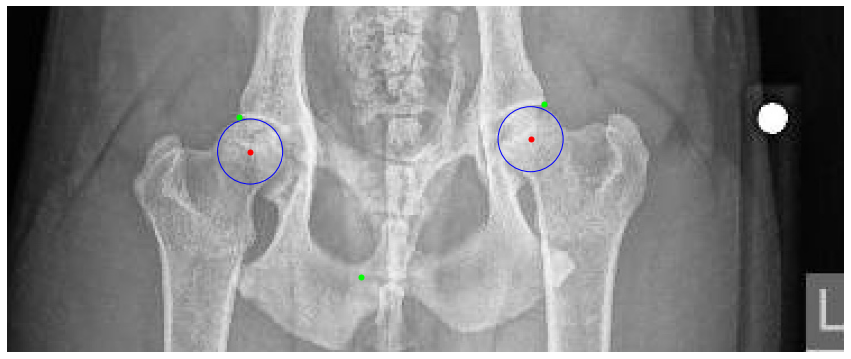

In [19]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg'
predict_and_plot(image_path, detector, detector2, pose_estimator, pose_estimator2, 
                 conf_thres_center=0.5, conf_thres_head=0.2)

In [20]:
def calculate_angle(center, head, opposite_center):
    """
    Calculate the angle formed by the three points: center1, head, and opposite_center.
    
    Parameters:
    - center1: The first center point.
    - head: The head point.
    - opposite_center: The opposite center point.
    
    Returns:
    - angle in degrees.
    """
    center = np.array(center)
    head = np.array(head)
    opposite_center = np.array(opposite_center)
    
    # Vector from center1 to head
    vector1 = head - center
    # Vector from center1 to opposite_center
    vector2 = opposite_center - center
    
    # Calculate the cosine of the angle using dot product and norms
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    
    # Clamp the cosine value to the range [-1, 1] to avoid numerical issues
    cos_angle = np.clip(cos_angle, -1.0, 1.0)
    
    # Calculate the angle in radians and then convert to degrees
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.32, conf_thres_head=0.5):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    angles = mat_data['Angles']
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

    # Center detection
    detect_result_center = inference_detector(detector, image_path)
    pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
    bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
    bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

    centers_pred = []
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        try:
            data_samples_center = merge_data_samples(pose_results_center)
            centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    # Head detection
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_head = inference_detector(detector2, image_path)
    pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
    bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
    bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

    heads_pred = []
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
        try:
            data_samples_head = merge_data_samples(pose_results_head)
            heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    # Initialize DataFrame with ground truth values
    df = pd.DataFrame({
        'Image Path': [image_path],
        'Left Head X': [left_head[0]],
        'Left Head Y': [left_head[1]],
        'Right Head X': [right_head[0]],
        'Right Head Y': [right_head[1]],
        'Center1 X': [center1[0]],
        'Center1 Y': [center1[1]],
        'Center2 X': [center2[0]],
        'Center2 Y': [center2[1]],
        'Radius1': [radius1],
        'Radius2': [radius2],
        'Angle1': [angles[0][0]],
        'Angle2': [angles[0][1]],
        'Pred Left Head X': [np.nan],
        'Pred Left Head Y': [np.nan],
        'Pred Right Head X': [np.nan],
        'Pred Right Head Y': [np.nan],
        'Pred Center1 X': [np.nan],
        'Pred Center1 Y': [np.nan],
        'Pred Center2 X': [np.nan],
        'Pred Center2 Y': [np.nan],
        'Pred Radius1': [np.nan],
        'Pred Radius2': [np.nan],
        'Pred Angle1': [np.nan],
        'Pred Angle2': [np.nan]
    })

    # Update DataFrame with predicted values if predictions are available
    if len(centers_pred) >= 2 and len(heads_pred) >= 2:
        # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
        centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
        heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

        predicted_radius1 = min(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
        predicted_radius2 = min(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
        predicted_angle1 = calculate_angle(centers_pred[0][0],heads_pred[0][0], centers_pred[1][0])
        predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])

        pred_left_head = heads_pred[0][0]
        pred_right_head = heads_pred[1][0]
        pred_center1 = centers_pred[0][0]
        pred_center2 = centers_pred[1][0]

        df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
        df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
        df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
        df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
        df.loc[0, 'Pred Center1 X'] = pred_center1[0]
        df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
        df.loc[0, 'Pred Center2 X'] = pred_center2[0]
        df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
        df.loc[0, 'Pred Radius1'] = predicted_radius1
        df.loc[0, 'Pred Radius2'] = predicted_radius2
        df.loc[0, 'Pred Angle1'] = predicted_angle1
        df.loc[0, 'Pred Angle2'] = predicted_angle2

    return df

def process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.32, conf_thres_head=0.5, output_dir='/home/featurize/work/Result'):
    image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    all_dfs = []

    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center, conf_thres_head)
            all_dfs.append(df)
        else:
            print(f'MAT file for image {image_file} not found.')

    # Combine all dataframes and save to CSV
    final_df = pd.concat(all_dfs, ignore_index=True)
    final_df.to_csv(os.path.join(output_dir, 'predictions.csv'), index=False)

# Example usage
#image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
#label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
#process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.39, conf_thres_head=0.46, output_dir='/home/featurize/work/Result')


In [21]:
## use different confidience threshold to compute best point

def calculate_angle(center, head, opposite_center):
    """
    Calculate the angle formed by the three points: center1, head, and opposite_center.
    
    Parameters:
    - center1: The first center point.
    - head: The head point.
    - opposite_center: The opposite center point.
    
    Returns:
    - angle in degrees.
    """
    center = np.array(center)
    head = np.array(head)
    opposite_center = np.array(opposite_center)
    
    # Vector from center1 to head
    vector1 = head - center
    # Vector from center1 to opposite_center
    vector2 = opposite_center - center
    
    # Calculate the cosine of the angle using dot product and norms
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    
    # Clamp the cosine value to the range [-1, 1] to avoid numerical issues
    cos_angle = np.clip(cos_angle, -1.0, 1.0)
    
    # Calculate the angle in radians and then convert to degrees
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def calculate_error(pred_points, true_points):
    return np.mean(np.linalg.norm(pred_points - true_points, axis=1))

def predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    Angles = mat_data['Angles']
    
    best_df = None
    best_error = float('inf')

    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            detect_result_center = inference_detector(detector, image_path)
            pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
            bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
            bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
            detect_result_head = inference_detector(detector2, image_path)
            pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
            bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
            bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Initialize DataFrame with ground truth values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Left Head X': [left_head[0]],
                'Left Head Y': [left_head[1]],
                'Right Head X': [right_head[0]],
                'Right Head Y': [right_head[1]],
                'Center1 X': [center1[0]],
                'Center1 Y': [center1[1]],
                'Center2 X': [center2[0]],
                'Center2 Y': [center2[1]],
                'Radius1': [radius1],
                'Radius2': [radius2],
                'Angle1': [Angles[0][0]],
                'Angle2': [Angles[0][1]],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) >= 2 and len(heads_pred) >= 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = min(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = min(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0],heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])


                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                # Calculate prediction error
                pred_points = np.array([pred_left_head, pred_right_head, pred_center1, pred_center2])
                true_points = np.array([left_head, right_head, center1, center2])
                error = calculate_error(pred_points, true_points)

                if error < best_error:
                    best_error = error
                    best_df = df

    return best_df

def process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        output_path = os.path.join(output_dir, 'predictions.csv')
        final_df.to_csv(output_path, index=False)

# Example usage
image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

Percentage of angles with less than 1 degree error: 15.00%
Percentage of angles with less than 5 degrees error: 71.67%
Percentage of angles with less than 10 degrees error: 97.50%
Percentage of Delta Angle1 < 5: 65.00%
Percentage of Delta Angle2 < 5: 78.33%
Percentage of Delta Angle1 < 10: 95.83%
Percentage of Delta Angle2 < 10: 99.17%
MAE for Angle1: 4.163218914485211
MAE for Angle2: 3.256850618020634
MAE for all Angles: 3.7100347662529223
MSE Point: 8.64328982982203
MSE Angle: 20.616159949257074
MSE Radius: 6.914707395865011
MAPE Point: 0.012728801707208227
MAPE Angle: 0.04150469722505369
MAPE Radius: 0.03608271703710136
R2 Head Left: 0.9947493488493488
R2 Head Right: 0.9974058170205407
R2 Center1: 0.9982827229152464
R2 Center2: 0.9988433743403331
R2 Angle: 0.9161673938305237
Percentage of same classification angle1: 61.67%
Percentage of same classification angle2: 55.00%


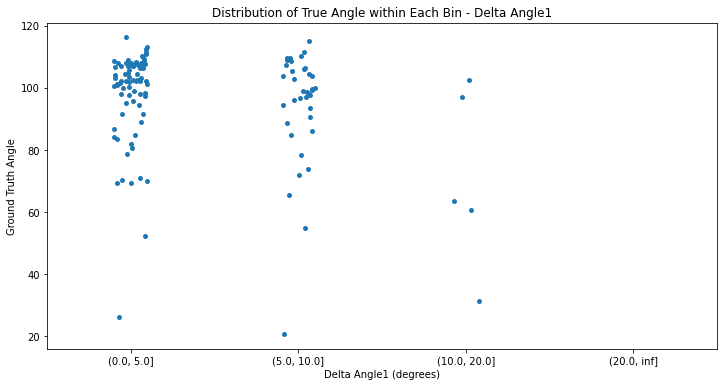

File: 340563.jpeg


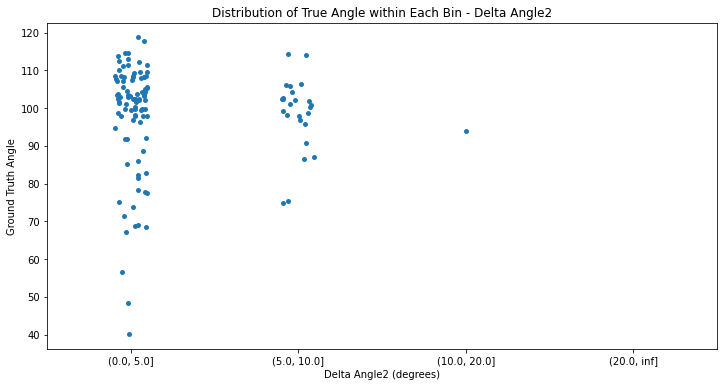

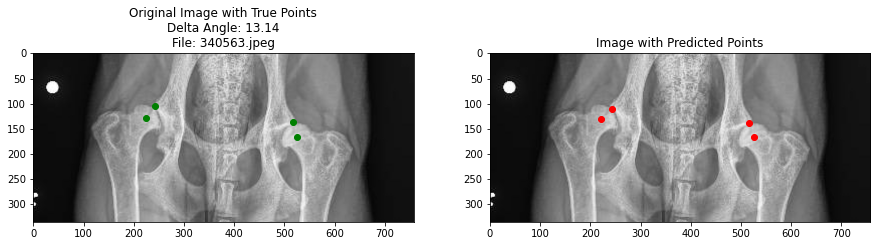

File: 353517.jpeg


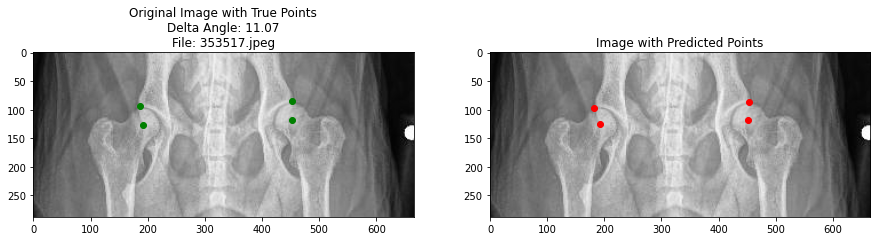

File: 341649.jpeg


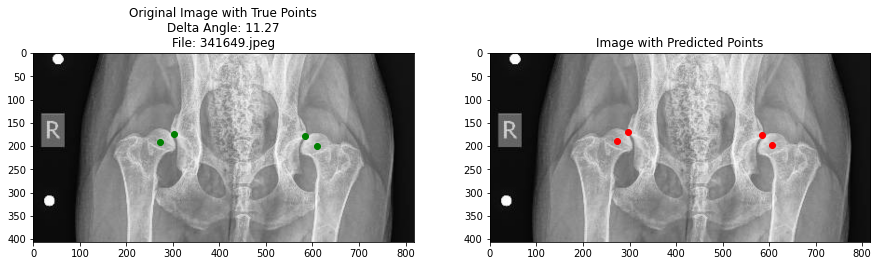

File: 357815.jpeg


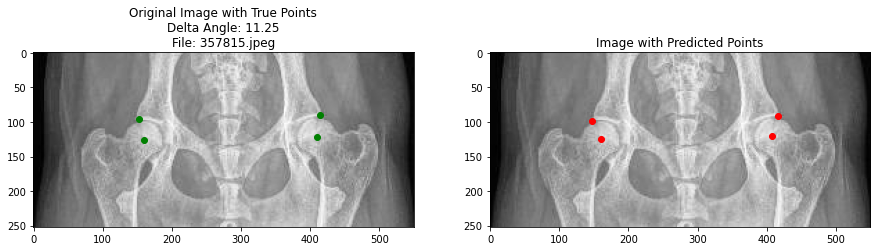

File: 357274.jpeg


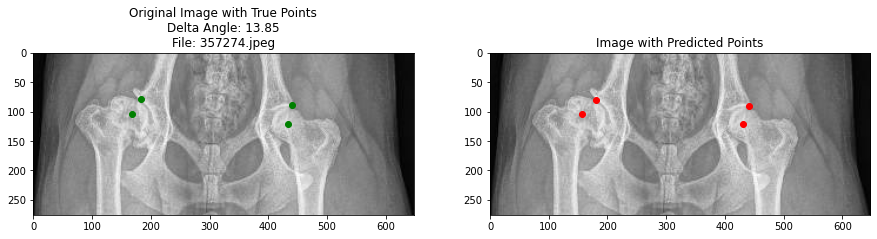

In [24]:
df= pd.read_csv('/home/featurize/work/Result/predictions.csv')
evaluate_df(df)

In [ ]:
def predict_image_only(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    
    best_df = None

    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            detect_result_center = inference_detector(detector, image_path)
            pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
            bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
            bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
            detect_result_head = inference_detector(detector2, image_path)
            pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
            bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
            bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Initialize DataFrame with predicted values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) >= 2 and len(heads_pred) >= 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = min(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = min(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0], heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])

                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                best_df = df
                break  

    return best_df

def process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        if image_path.lower().endswith(('.jpg', '.jpeg', '.png')):
            df = predict_image_only(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        output_path = os.path.join(output_dir, 'predictions_without_gt.csv')
        final_df.to_csv(output_path, index=False)

In [ ]:
# read unlabeled dataset
image_dir = '/home/featurize/work/Dataset2/data/July_2024'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [ ]:
df = pd.read_csv('/home/featurize/work/Result/predictions_without_gt.csv')
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)

In [22]:
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score,mean_absolute_error
import seaborn as sns

def classify_na(angle):
    if angle >= 105:
        return 'Excellent'
    elif 100 <= angle < 105:
        return 'Good'
    elif 95 <= angle < 100:
        return 'Fair'
    elif 90 <= angle < 95:
        return 'Borderline'
    elif 85 <= angle < 90:
        return 'Mild'
    elif 80 <= angle < 85:
        return 'Moderate'
    elif angle < 80:
        return 'Severe'
    else:
        return 'Unknown'
    
def evaluate_df(df):
    # delta_angle
    df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
    df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

    percentage_less_than_1_degree = (
        ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
    ) * 100

    # 计算误差小于5度的百分比
    percentage_less_than_5_degrees = (
        ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
    ) * 100

    # 计算误差小于10度的百分比
    percentage_less_than_10_degrees = (
        ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
    ) * 100

    print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
    print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
    print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

    angle1_under_5 = (df['Delta Angle1'] < 5).sum()
    angle2_under_5 = (df['Delta Angle2'] < 5).sum()
    total_entries = len(df)

    percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
    percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
    print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

    angle1_under_10 = (df['Delta Angle1'] < 10).sum()
    angle2_under_10 = (df['Delta Angle2'] < 10).sum()

    percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
    percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
    print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")
    
    mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
    mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
    combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
    combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
    mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)


    print(f"MAE for Angle1: {mae_angle1}")
    print(f"MAE for Angle2: {mae_angle2}")
    print(f"MAE for all Angles: {mae_combined_angles}")


    # mse
    mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                   df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

    mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                                   df[['Pred Angle1', 'Pred Angle2']])

    mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                    df[['Pred Radius1', 'Pred Radius2']])

    # MAPE
    mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                                df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X','Pred Center2 Y']])

    mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                                df[['Pred Angle1', 'Pred Angle2']])

    mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                                 df[['Pred Radius1', 'Pred Radius2']])

    # R2
    r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                            df[['Pred Left Head X', 'Pred Left Head Y']])

    r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                             df[['Pred Right Head X', 'Pred Right Head Y']])

    r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                          df[['Pred Center1 X', 'Pred Center1 Y']])

    r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                          df[['Pred Center2 X', 'Pred Center2 Y']])

    r2_angle = r2_score(df[['Angle1', 'Angle2']],
                        df[['Pred Angle1', 'Pred Angle2']])



    print(f"MSE Point: {mse_point}")
    print(f"MSE Angle: {mse_angle}")
    print(f"MSE Radius: {mse_radius}")
    print(f"MAPE Point: {mape_point}")
    print(f"MAPE Angle: {mape_angle}")
    print(f"MAPE Radius: {mape_radius}")
    print(f"R2 Head Left: {r2_head_left}")
    print(f"R2 Head Right: {r2_head_right}")
    print(f"R2 Center1: {r2_center1}")
    print(f"R2 Center2: {r2_center2}")
    print(f"R2 Angle: {r2_angle}")
    
    
    df['Angle1 Classification'] = df['Angle1'].apply(classify_na)
    df['Angle2 Classification'] = df['Angle2'].apply(classify_na)

    df['Pred Angle1 Classification'] = df['Pred Angle1'].apply(classify_na)
    df['Pred Angle2 Classification'] = df['Pred Angle2'].apply(classify_na)
    
    total_count = len(df)
    same_classification_count1 = (df['Angle1 Classification'] == df['Pred Angle1 Classification']).sum()
    percentage_same_classification1 = (same_classification_count1 / total_count) * 100

    print(f"Percentage of same classification angle1: {percentage_same_classification1:.2f}%")

    same_classification_count2 = (df['Angle2 Classification'] == df['Pred Angle2 Classification']).sum()
    percentage_same_classification2 = (same_classification_count2 / total_count) * 100

    print(f"Percentage of same classification angle2: {percentage_same_classification2:.2f}%")
    
    ##
    df['Delta Angle1 Bin'] = pd.cut(df['Delta Angle1'], bins=[0, 5, 10, 20, float('inf')])
    df['Delta Angle2 Bin'] = pd.cut(df['Delta Angle2'], bins=[0, 5, 10, 20, float('inf')])

    # Delta Angle1
    plt.figure(figsize=(12, 6))
    sns.stripplot(x='Delta Angle1 Bin', y='Angle1', data=df, jitter=True)
    plt.xlabel('Delta Angle1 (degrees)')
    plt.ylabel('Ground Truth Angle')
    plt.title('Distribution of True Angle within Each Bin - Delta Angle1')
    plt.show()

    # Delta Angle2
    plt.figure(figsize=(12, 6))
    sns.stripplot(x='Delta Angle2 Bin', y='Angle2', data=df, jitter=True)
    plt.xlabel('Delta Angle2 (degrees)')
    plt.ylabel('Ground Truth Angle')
    plt.title('Distribution of True Angle within Each Bin - Delta Angle2')
    
    
    filtered_df = df[(df['Delta Angle1'] > 10)]
    for index, row in filtered_df.iterrows():
        image_path = row['Image Path']
        image_name = os.path.basename(image_path)
        image = cv2.imread(image_path)
        print(f'File: {image_name}')

        true_points = np.array([
            [row['Left Head X'], row['Left Head Y']],
            [row['Right Head X'], row['Right Head Y']],
            [row['Center1 X'], row['Center1 Y']],
            [row['Center2 X'], row['Center2 Y']]
        ], dtype=int)


        pred_points = np.array([
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']]
        ], dtype=int)

        fig, ax = plt.subplots(1, 2, figsize=(15, 7))


        ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for point in true_points:
            ax[0].plot(point[0], point[1], 'go')  

        ax[0].set_title(f'Original Image with True Points\nDelta Angle: {row["Delta Angle1"]:.2f}\nFile: {image_name}')


        ax[1].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for point in pred_points:
            ax[1].plot(point[0], point[1], 'ro') 

        ax[1].set_title('Image with Predicted Points')

        plt.show()

In [23]:
evaluate_df(df)

NameError: name 'df' is not defined

In [ ]:
def save_predictions_to_mat(df, output_dir):
    for index, row in df.iterrows():
        
        image_file_name = os.path.splitext(os.path.basename(row['Image Path']))[0]
        
        
        four_points = np.array([
           
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']],
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Radius1'], row['Pred Radius2']]
        ])
        
        
        angles = np.array([[row['Pred Angle1'], row['Pred Angle2']]])
        
        
        mat_content = {
            '__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: ' + bytes(pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S'), 'utf-8'),
            '__version__': '1.0',
            '__globals__': [],
            'Four_points': four_points,
            'Angles': angles
        }
        
        
        file_name = f"{image_file_name}.mat"
        file_path = os.path.join(output_dir, file_name)
        
        
        scipy.io.savemat(file_path, mat_content)
        print(f"Saved predictions to {file_path}")


#output_dir = '/home/featurize/work/Result/Predict'
#save_predictions_to_mat(df, output_dir)

In [ ]:
image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
conf_thres_center_range = np.arange(0.3, 0.8, 0.05)
conf_thres_head_range = np.arange(0.3, 0.8, 0.05)
output_dir = '/home/featurize/work/Result'

process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [ ]:
df= pd.read_csv('/home/featurize/work/Result/predictions.csv')
# delta_angle

df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

percentage_less_than_1_degree = (
    ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
) * 100

# 计算误差小于5度的百分比
percentage_less_than_5_degrees = (
    ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
) * 100

# 计算误差小于10度的百分比
percentage_less_than_10_degrees = (
    ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
) * 100

print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

angle1_under_5 = (df['Delta Angle1'] < 5).sum()
angle2_under_5 = (df['Delta Angle2'] < 5).sum()
total_entries = len(df)

percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

angle1_under_10 = (df['Delta Angle1'] < 10).sum()
angle2_under_10 = (df['Delta Angle2'] < 10).sum()

percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")

import seaborn as sns
df['Delta Angle1 Bin'] = pd.cut(df['Delta Angle1'], bins=[0, 5, 10, 20, float('inf')])
df['Delta Angle2 Bin'] = pd.cut(df['Delta Angle2'], bins=[0, 5, 10, 20, float('inf')])

# Delta Angle1
plt.figure(figsize=(12, 6))
sns.stripplot(x='Delta Angle1 Bin', y='Angle1', data=df, jitter=True)
plt.xlabel('Delta Angle1 (degrees)')
plt.ylabel('Ground Truth Angle')
plt.title('Distribution of True Angle within Each Bin - Delta Angle1')
plt.show()

# Delta Angle2
plt.figure(figsize=(12, 6))
sns.stripplot(x='Delta Angle2 Bin', y='Angle2', data=df, jitter=True)
plt.xlabel('Delta Angle2 (degrees)')
plt.ylabel('Ground Truth Angle')
plt.title('Distribution of True Angle within Each Bin - Delta Angle2')
plt.show()

from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score,mean_absolute_error

# mae
mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)




# mse
mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                               df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                               df[['Pred Angle1', 'Pred Angle2']])

mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                df[['Pred Radius1', 'Pred Radius2']])

# MAPE
mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                            df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X','Pred Center2 Y']])

mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                            df[['Pred Angle1', 'Pred Angle2']])

mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                             df[['Pred Radius1', 'Pred Radius2']])

# R2
r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                        df[['Pred Left Head X', 'Pred Left Head Y']])

r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                         df[['Pred Right Head X', 'Pred Right Head Y']])

r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                      df[['Pred Center1 X', 'Pred Center1 Y']])

r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                      df[['Pred Center2 X', 'Pred Center2 Y']])

r2_angle = r2_score(df[['Angle1', 'Angle2']],
                    df[['Pred Angle1', 'Pred Angle2']])

print(f"MAE for Angle1: {mae_angle1}")
print(f"MAE for Angle2: {mae_angle2}")
print(f"MAE for all Angles: {mae_combined_angles}")

print(f"MSE Point: {mse_point}")
print(f"MSE Angle: {mse_angle}")
print(f"MSE Radius: {mse_radius}")
print(f"MAPE Point: {mape_point}")
print(f"MAPE Angle: {mape_angle}")
print(f"MAPE Radius: {mape_radius}")
print(f"R2 Head Left: {r2_head_left}")
print(f"R2 Head Right: {r2_head_right}")
print(f"R2 Center1: {r2_center1}")
print(f"R2 Center2: {r2_center2}")
print(f"R2 Angle: {r2_angle}")

In [ ]:
def classify_na(angle):
    if angle >= 105:
        return 'Excellent'
    elif 100 <= angle < 105:
        return 'Good'
    elif 95 <= angle < 100:
        return 'Fair'
    elif 90 <= angle < 95:
        return 'Borderline'
    elif 85 <= angle < 90:
        return 'Mild'
    elif 80 <= angle < 85:
        return 'Moderate'
    elif angle < 80:
        return 'Severe'
    else:
        return 'Unknown'


In [ ]:
df['Angle1 Classification'] = df['Angle1'].apply(classify_na)
df['Angle2 Classification'] = df['Angle2'].apply(classify_na)

df['Pred Angle1 Classification'] = df['Pred Angle1'].apply(classify_na)
df['Pred Angle2 Classification'] = df['Pred Angle2'].apply(classify_na)

In [ ]:
total_count = len(df)
same_classification_count1 = (df['Angle1 Classification'] == df['Pred Angle1 Classification']).sum()
percentage_same_classification1 = (same_classification_count1 / total_count) * 100

print(f"Percentage of same classification angle1: {percentage_same_classification1:.2f}%")

same_classification_count2 = (df['Angle2 Classification'] == df['Pred Angle2 Classification']).sum()
percentage_same_classification2 = (same_classification_count2 / total_count) * 100

print(f"Percentage of same classification angle2: {percentage_same_classification2:.2f}%")

In [ ]:
df1 = df[['Angle1', 'Pred Angle1', 'Angle1 Classification', 'Pred Angle1 Classification']]
df1.to_csv('/home/featurize/work/mmpose/data/predictions_classified.csv', index=False)

In [ ]:
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)

In [ ]:
# read unlabeled dataset
image_dir = '/home/featurize/work/Dataset2/data/July_2024'
conf_thres_center_range = np.arange(0.3, 0.7, 0.05)
conf_thres_head_range = np.arange(0.3, 0.7, 0.05)
output_dir = '/home/featurize/work/Result/July2024'

process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [ ]:
df= pd.read_csv('/home/featurize/work/Result/July2024/predictions_without_gt.csv')
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)